# PCA and Factor Analysis for JGB Yield Decomposition & Prediction 

## Table of Contents
- [1. Loading the Data *(Bloomberg)*](#section-1)
  * [1.1 Short-term Maturities Yields](#subsection-11)
  * [1.2 Medium-term Maturities Yields](#subsection-12)
  * [1.3 Long-term Maturities Yields](#subsection-13)
  * [1.4 Yield-Related Features](#subsection-14)
$$$$
- [2. Data Preparation & EDA](#section-2)
  * [2.1 Checking for Outliers](#subsection-21)
  * [2.2 Train-Test Split (70% - 30%)](#subsection-22)
  * [2.3 Z-score Normalization](#subsection-23)
  * [2.4 Time Series Decomposition *(Additive)*](#subsection-24)
  * [2.5 Correlation](#subsection-25)
  * [2.6 Distribution](#subsection-26)
$$$$
- [3. PCA](#section-3)
  * [3.1 Decomposition : Eigen vs Singular Value](#subsection-31)
  * [3.2 Explained Variance](#subsection-32)
  * [3.3 Top 3 Components : Level, Slope & Curvature](#subsection-33)
  * [3.4 Yield Curve Reconstruction : Variance Retained?](#subsection-34)
$$$$
- [4. Factor Analysis](#section-4)
  * [4.1 Singular Value Decomposition](#subsection-41)
  * [4.2 Explained Variance](#subsection-42)
  * [4.3 Top 3 Latent Factors : Level, Slope & Curvature](#subsection-43)
  * [4.4 Yield Curve Reconstruction : Variance Retained?](#subsection-44)
$$$$
- [5. Stacking Up Against Textbook Models](#section-5)  
  * [5.1 Nelson-Siegel Model](#subsection-51)
  * [5.2 Swensson Model](#subsection-52)
$$$$
- [6. Forecasting of 10-Year Treasury Yields](#section-6)
  * [6.1 Prediction Performance](#subsection-61)
  * [6.2 AutoRegressive Model](#subsection-62)
  * [6.3 Lagged Variable of 10-Year Treasury Yield as Y](#subsection-63)
  * [6.4 Ordinary Least Squares](#subsection-64)
  * [6.5 Recursive Feature Elimination](#subsection-65)
  * [6.6 L2 & L1 Regularization](#subsection-66)

## Objective

This notebook illustrates how principal component and factor analysis can break down changes in the shape of the yield curve for Japanese government bonds (JGBs) into three components : level, slope, and curvature. The yield curve can be reconstructed by projecting original yields for each maturity into this three-dimensional feature space, with 99% of the original variance preserved. This allows traders to focus on key risk factors for hedging interest rate risk.

The extracted yield curve component scores are then combined with other features as input to our linear regression model to predict 10-year yields. Quality of prediction is evaluated not only by regression & time series forecasting metrics, but also by accuracy of movements after each BoJ Monetary Policy Meeting.

## Refresher on Yield Curve Terminology 

**Normal Yield Curve *(Upward Sloping)***
> Markets expect steady economic growth & moderate inflation, and demand higher yields for longer tenor treasuries due to greater uncertainty.

**Steep Yield Curve *(Steep Upward Sloping)***
> Markets expect strong economic growth and have heightened expectations for higher inflation and rate hikes. This leads to sell-offs in long-term treasuries, which pushes their prices down and the right end of the yield curve up steeply, resulting in a larger positive term premium.

**Flat Yield Curve *(Horizontal)***
> In reaction to rising inflation, the Central Bank hikes the overnight call rate, which pushes the left end of the yield curve up. Simultaneously, inflation & growth expectations fall, so the middle & right-ends of the yield curve remain achored, resulting in a term premium equal to 0.

**Inverted Yield Curve *(Downward Sloping)***
> Markets expect economic slowdown, and have heightened expectations for lower inflation and rate cuts. This leads to mass buys of medium & long term treasuries, which pushes their prices up and the middle & right ends of the yield curve down, resulting in a negative term premium.

## Importing the Necessary Libraries

In [1]:
import pandas as pd 
import pandas_datareader.data as web
import numpy as np 
import yfinance as yf 
import matplotlib.pyplot as plt 
import seaborn as sns 
import scipy as sp 
from sklearn import preprocessing, decomposition, model_selection, linear_model, neighbors, feature_selection, metrics  
from statsmodels import tools, regression, discrete 
from statsmodels.tsa import seasonal, stattools, ar_model 
from statsmodels.graphics import gofplots, tsaplots 
rs = np.random.seed(123)
# pd.set_option("display.max_rows", None)  
# pd.set_option("display.max_columns", None) 
pd.set_option("display.float_format", "{:.4f}".format) 
import warnings
warnings.filterwarnings("ignore") 

In [2]:
from matplotlib_inline.backend_inline import set_matplotlib_formats
set_matplotlib_formats("svg") 

## 1. Loading the Data *(Bloomberg)*
<a id="section-1"></a>

### 1.1 Short-term Maturities Yields
<a id="subsection-11"></a>

- **JGBS1Y** 
> Japan Govt Bond 1Yr Compound Yield
- **JGBS2Y** 
> Japan Govt Bond 2Yr Compound Yield
- **JGBS3Y** 
> Japan Govt Bond 3Yr Compound Yield

### 1.2 Medium-term Maturities Yields
<a id="subsection-12"></a>

- **JGBS4Y** 
> Japan Govt Bond 4Yr Compound Yield
- **JGBS5Y** 
> Japan Govt Bond 5Yr Compound Yield
- **JGBS6Y** 
> Japan Govt Bond 6Yr Compound Yield
- **JGBS7Y** 
> Japan Govt Bond 7Yr Compound Yield
- **JGBS8Y** 
> Japan Govt Bond 8Yr Compound Yield
- **JGBS9Y** 
> Japan Govt Bond 9Yr Compound Yield
- **JGBS10Y** 
> Japan Govt Bond 10Yr Compound Yield

### 1.3 Long-term Maturities Yields
<a id="subsection-13"></a>

- **JGBS15Y** 
> Japan Govt Bond 15Yr Compound Yield
- **JGBS20Y** 
> Japan Govt Bond 20Yr Compound Yield
- **JGBS25Y** 
> Japan Govt Bond 25Yr Compound Yield
- **JGBS30Y** 
> Japan Govt Bond 30Yr Compound Yield
- **JGBS40Y** 
> Japan Govt Bond 40Yr Compound Yield

In [3]:
jgb_yields = pd.read_excel("file_path/JGB Yields.xlsx", 
                          parse_dates = ["Date"], index_col = "Date")
jgb_yields.columns = [tenor[4:] for tenor in jgb_yields.columns]

In [4]:
jgb_yields = jgb_yields.asfreq("B")
jgb_yields.ffill(inplace = True)

In [5]:
jgb_yields

,1Y,2Y,3Y,4Y,5Y,6Y,7Y,8Y,9Y,10Y,15Y,20Y,25Y,30Y
Date,,,,,,,,,,,,,,
2014-01-01,0.0800,0.0980,0.1280,0.1840,0.2380,0.3370,0.4710,0.5830,0.6700,0.7360,1.1350,1.5840,1.6800,1.7260
2014-01-02,0.0800,0.0980,0.1280,0.1840,0.2380,0.3370,0.4710,0.5830,0.6700,0.7360,1.1350,1.5840,1.6800,1.7260
2014-01-03,0.0800,0.0980,0.1280,0.1840,0.2380,0.3370,0.4710,0.5830,0.6700,0.7360,1.1350,1.5840,1.6800,1.7260
2014-01-06,0.0800,0.0910,0.1240,0.1750,0.2290,0.3240,0.4590,0.5700,0.6580,0.7250,1.1230,1.5720,1.6710,1.7180
2014-01-07,0.0800,0.0910,0.1200,0.1650,0.2190,0.3090,0.4340,0.5460,0.6290,0.6960,1.1030,1.5540,1.6570,1.7050
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-07-25,0.1890,0.4030,0.4410,0.5320,0.6370,0.6790,0.7750,0.8740,0.9670,1.0780,1.5430,1.8470,2.0520,2.1680
2024-07-26,0.1900,0.4080,0.4420,0.5340,0.6310,0.6740,0.7690,0.8630,0.9590,1.0680,1.5220,1.8350,2.0320,2.1540
2024-07-29,0.1820,0.3940,0.4250,0.5110,0.6070,0.6510,0.7400,0.8360,0.9310,1.0410,1.4970,1.8140,2.0090,2.1300


### 1.4 Yield-Related Features
<a id="subsection-14"></a>

- **.U-J10YRS G Index** 
> Global CIX: us-japan 10-yr spread 
- **USDJPY Curncy** 
> United States Dollar / Japanese Yen Cross 
- **NKY Index** 
> Nikkei 225

In [6]:
related_feats = pd.read_excel("C:/Users/khail/OneDrive/Desktop/DRW/Internship/BOJ Project/Yield-Related Features.xlsx", 
                              parse_dates = ["Date"], index_col = "Date") 

In [7]:
related_feats 

,.U-J10YRS G,USDJPY,NKY
Date,,,
2014-01-01,228.7162,105.2500,16291.3100
2014-01-02,224.8046,104.8100,16291.3100
2014-01-03,225.3805,104.8600,16291.3100
2014-01-06,223.0629,104.2200,15908.8800
2014-01-07,224.2107,104.6000,15814.3700
...,...,...,...
2024-07-25,318.1729,153.9400,37869.5100
2024-07-26,312.6858,153.7600,37667.4100
2024-07-29,314.7383,154.0200,38468.6300


## 2. Data Preparation & EDA
<a id="section-2"></a>

### 2.1 Checking for Outliers 
<a id="subsection-21"></a>

In [8]:
jgb_yields.info( )

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2761 entries, 2014-01-01 to 2024-07-31
Freq: B
Data columns (total 14 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   1Y      2761 non-null   float64
 1   2Y      2761 non-null   float64
 2   3Y      2761 non-null   float64
 3   4Y      2761 non-null   float64
 4   5Y      2761 non-null   float64
 5   6Y      2761 non-null   float64
 6   7Y      2761 non-null   float64
 7   8Y      2761 non-null   float64
 8   9Y      2761 non-null   float64
 9   10Y     2761 non-null   float64
 10  15Y     2761 non-null   float64
 11  20Y     2761 non-null   float64
 12  25Y     2761 non-null   float64
 13  30Y     2761 non-null   float64
dtypes: float64(14)
memory usage: 323.6 KB


### 2.2 Train-Test Split (70% - 30%)
<a id="subsection-22"></a>

In [9]:
def train_test_split(X_df, Y = None, train_size = 0.7) :
    """
    Arguments :
    - X_df : DataFrame for the explanatory time series data 
    - Y : Series for the response time series data 
    - train_size : float for the % of the time series data allocated for training 
    
    Function :
    - Splits the explanatory time series data according to (train_size, 1 - train_size) ratio 
    - If specified, splits the response time series data according to (train_size, 1 - train_size) ratio 
    """
    if Y is not None :
        X_train, X_test, Y_train, Y_test = model_selection.train_test_split(X_df, Y, train_size = train_size, shuffle = False)
        return X_train, X_test, Y_train, Y_test 
    else :
        X_train, X_test = model_selection.train_test_split(X_df, train_size = train_size, shuffle = False)
        return X_train, X_test 

In [10]:
yields_train, yields_test = train_test_split(jgb_yields)

### 2.3 Z-Score Normalization 
<a id="subsection-23"></a>

$$z_{ij} = \frac{x_{ij} - \bar{x}_j}{\sigma_j}$$ 

$\text{Where :}$
- $\bar{x}_j \text{ is the mean of the \( j \)-th feature}$
- $\sigma_j \text{ is the standard deviation of the \( j \)-th feature}$

In [11]:
def z_score_normalize(X_train_df, X_test_df) :
    """
    Arguments :
    - X_train_df : DataFrame for the explanatory training data 
    - X_test_df : DataFrame for the explanatory test data 
    
    Returns :
    - X_train_s_df : DataFrame for the standardized explanatory training data 
    - X_test_s_df : DataFrame for the standardized explanatory test data 
    
    Function :
    - Divides the difference between each value and the average of its column by the standard deviation of its column 
    """
    std_scaler = preprocessing.StandardScaler( )
    X_train_s_df = pd.DataFrame(std_scaler.fit_transform(X_train_df), index = X_train_df.index, columns = X_train_df.columns)
    X_test_s_df = pd.DataFrame(std_scaler.transform(X_test_df), index = X_test_df.index, columns = X_test_df.columns)
    
    return std_scaler, X_train_s_df, X_test_s_df 

In [12]:
yields_train_s = z_score_normalize(yields_train, yields_test)[1]

In [13]:
yields_train_s

,1Y,2Y,3Y,4Y,5Y,6Y,7Y,8Y,9Y,10Y,15Y,20Y,25Y,30Y
Date,,,,,,,,,,,,,,
2014-01-01,1.8831,2.0423,2.1325,2.2551,2.2910,2.6176,2.8382,2.7890,2.7837,2.7067,2.4300,2.2908,2.0838,1.9529
2014-01-02,1.8831,2.0423,2.1325,2.2551,2.2910,2.6176,2.8382,2.7890,2.7837,2.7067,2.4300,2.2908,2.0838,1.9529
2014-01-03,1.8831,2.0423,2.1325,2.2551,2.2910,2.6176,2.8382,2.7890,2.7837,2.7067,2.4300,2.2908,2.0838,1.9529
2014-01-06,1.8831,1.9756,2.0961,2.1811,2.2242,2.5308,2.7699,2.7245,2.7277,2.6577,2.3904,2.2607,2.0628,1.9347
2014-01-07,1.8831,1.9756,2.0598,2.0990,2.1500,2.4307,2.6276,2.6053,2.5924,2.5287,2.3243,2.2156,2.0301,1.9051
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-21,0.0027,-0.1209,-0.2209,-0.2094,-0.1353,-0.0732,-0.0875,-0.1197,-0.1708,-0.1860,-0.3936,-0.5369,-0.5236,-0.4337
2021-05-24,-0.0159,-0.1305,-0.2027,-0.2587,-0.1724,-0.1066,-0.1103,-0.1396,-0.1895,-0.1994,-0.4101,-0.5469,-0.5260,-0.4406
2021-05-25,-0.0159,-0.1305,-0.2027,-0.2587,-0.1724,-0.1400,-0.1444,-0.1644,-0.2035,-0.2216,-0.4234,-0.5595,-0.5353,-0.4428


In [14]:
yields_test_s = z_score_normalize(yields_train, yields_test)[2] 

In [15]:
yields_test_s

,1Y,2Y,3Y,4Y,5Y,6Y,7Y,8Y,9Y,10Y,15Y,20Y,25Y,30Y
Date,,,,,,,,,,,,,,
2021-05-28,-0.0344,-0.1876,-0.2027,-0.2752,-0.1353,-0.1066,-0.0818,-0.1396,-0.1708,-0.1727,-0.3903,-0.5344,-0.5166,-0.4406
2021-05-31,0.0397,-0.0828,-0.2118,-0.2752,-0.1650,-0.1066,-0.0989,-0.1346,-0.1801,-0.1949,-0.4068,-0.5444,-0.5236,-0.4406
2021-06-01,0.0305,-0.0828,-0.2118,-0.2752,-0.1576,-0.1066,-0.1103,-0.1346,-0.1754,-0.1905,-0.4068,-0.5444,-0.5143,-0.4223
2021-06-02,0.0212,-0.0828,-0.2118,-0.2752,-0.1576,-0.1066,-0.1046,-0.1346,-0.1708,-0.1949,-0.3903,-0.5219,-0.4957,-0.4064
2021-06-03,0.0119,-0.0352,-0.2118,-0.2752,-0.1576,-0.1066,-0.1046,-0.1346,-0.1661,-0.1682,-0.3738,-0.5194,-0.4910,-0.4132
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-07-25,2.8927,4.9488,4.9764,5.1139,5.2516,4.9012,4.5686,4.2334,4.1700,4.2287,3.7774,2.9501,2.9513,2.9594
2024-07-26,2.9020,4.9965,4.9855,5.1303,5.2071,4.8678,4.5344,4.1788,4.1326,4.1842,3.7081,2.9200,2.9047,2.9276
2024-07-29,2.8279,4.8631,4.8310,4.9414,5.0290,4.7142,4.3694,4.0448,4.0020,4.0640,3.6255,2.8674,2.8511,2.8729


### 2.4 Time Series Decomposition & Testing For Stationarity
<a id="subsection-24"></a>

In [16]:
def plot_time_series(ts_df, ylabel) :
    """
    Arguments :
    - ts_df : DataFrame of time series data with daily frequency 
    - ylabel : str for the label to display on the y-axis of the line plot 
    
    Returns :
    - None 
    
    Function :
    - Draws a line plot of each time series 
    """      
    plt.figure(figsize = (12, 7))
    if ts_df.shape[1] <= 10 :
        colors = sns.color_palette("tab10")
    else :
        colors = sns.color_palette("tab20")
    
    for i, ticker in enumerate(ts_df.columns) :
        plt.plot(ts_df[ticker], color = colors[i], label = ticker, linewidth = 1.0)

    plt.ylabel(ylabel, fontsize = 12)
    # plt.yticks(ticks = np.arange(round(ts_df.min( ).min( ), 1), ts_df.max( ).max( ) + 0.2,  0.2))
    plt.legend( )
    plt.style.use("default") 
    plt.show( )

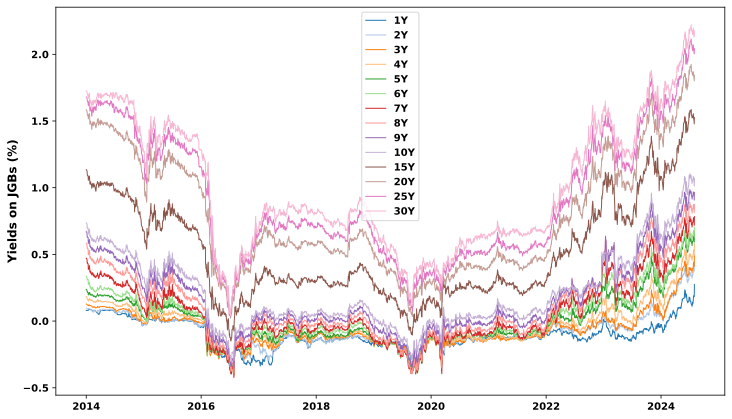

In [17]:
plot_time_series(jgb_yields, "Yields on JGBs (%)")

In [18]:
def plot_rolling_vol(ts_df, window) :
    """
    Arguments :
    - ts_df : DataFrame of time series data with daily frequency 
    - window : int for the interval of the rolling window (days)
    
    Returns :
    - None 
    
    Function :
    - Draws a line plot of the rolling standard deviation of each time series 
    """   
    rolling_vol = ts_df.rolling(window).std( ) 
    
    plt.figure(figsize = (12, 8))
    colors = sns.color_palette("tab20")
    
    for i, ticker in enumerate(rolling_vol.columns) :
        plt.plot(rolling_vol[ticker] * 100, color = colors[i], label = ticker, linewidth = 1.0)
    
    plt.ylabel("Rolling Volatility (%)", fontsize = 12)
    plt.yticks(ticks = np.arange(0, rolling_vol.max( ).max( ) * 100 + 5, 5))
    plt.legend( )
    plt.style.use("default") 
    plt.show( )

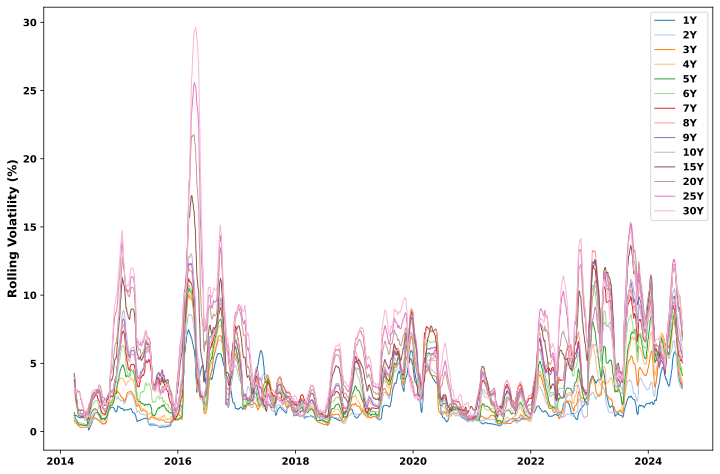

In [19]:
plot_rolling_vol(jgb_yields, 63)

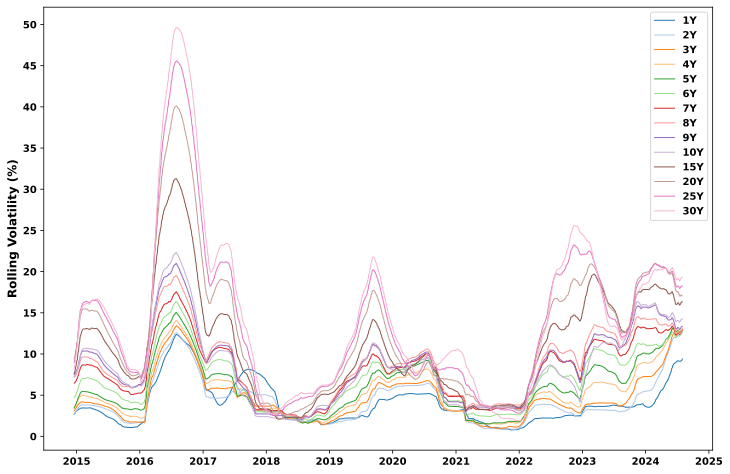

In [20]:
plot_rolling_vol(jgb_yields, 252)

$$Y_t = T_t + S_t + R_t$$

$\text{Where :}$
- $ Y_t \text{ is the observed value at time $t$.} $
- $ T_t \text{ is the trend component, representing the long-term progression of the series.} $
- $ S_t \text{ is the seasonal component, capturing the repeating short-term cycle.} $
- $ R_t \text{ is the residual component, representing random noise or unexplained variation.} $

In [21]:
def plot_seasonal_decomp(ts_df, component) :
    """
    Arguments :
    - ts_df : DataFrame of time series data with daily frequency 
    - component : str for one of the three components of additive decomposition -> "trend" or "seasonal" or "residual"
    
    Returns :
    - None 
    
    Function :
    - Conducts additive decomposition of each time series
    - Extracts, and draws a line plot of, the specified component for each time series 
    """       
    fig, ax = plt.subplots(nrows = ts_df.shape[1], ncols = 1, figsize = (12, ts_df.shape[1] * 5))
    if ts_df.shape[1] <= 10 :
        colors = sns.color_palette("tab10")
    else :
        colors = sns.color_palette("tab20")
    
    for i, ticker in enumerate(ts_df.columns) :
        decomp = seasonal.seasonal_decompose(x = ts_df[ticker], model = "additive")
        
        if component == "trend" :
            x = decomp.trend
        elif component == "seasonal" :
            x = decomp.seasonal
        elif component == "residual" :
            x = decomp.resid 
        
        ax[i].plot(x, color = colors[i], label = ticker)
        ax[i].set_ylabel(component.title( ), fontsize = 12)
        ax[i].legend( )
    
    plt.style.use("default") 
    plt.show( )

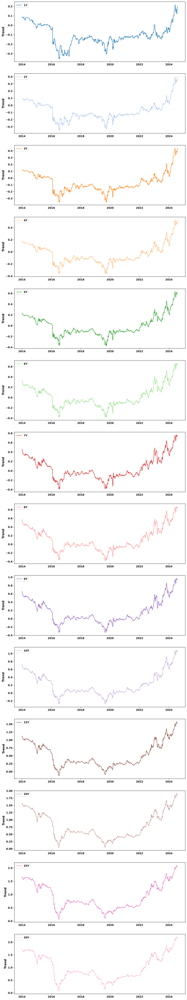

In [22]:
plot_seasonal_decomp(jgb_yields, component = "trend")

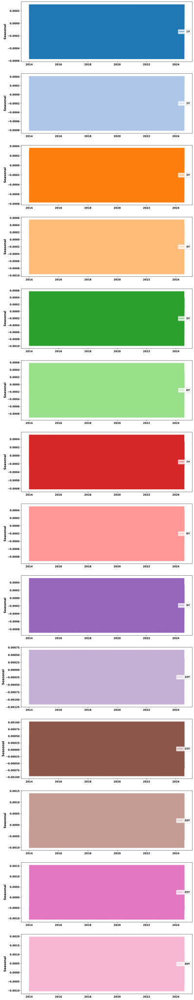

In [23]:
plot_seasonal_decomp(jgb_yields, component = "seasonal")

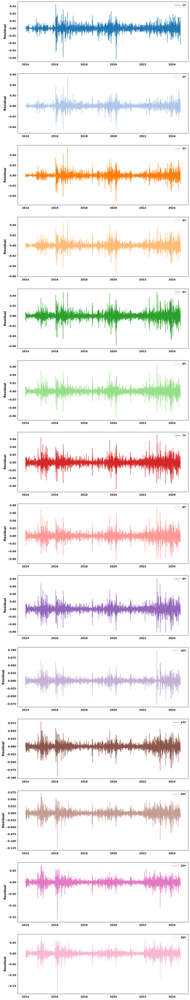

In [24]:
plot_seasonal_decomp(jgb_yields, component = "residual")

$\text{The formula for the Augmented Dickey-Fuller (ADF) test of stationarity is as follows :}$

$$\Delta y_t = \alpha + \beta t + \gamma y_{t-1} + \sum_{i=1}^{p-1} \delta_i \Delta y_{t-i} + \epsilon_t$$

$\text{Where :}$

- $ \Delta y_t \text{ is the first difference of the series \(y_t\).} $
- $ \alpha \text{ is a constant term (intercept).} $
- $ \beta t \text{ is a deterministic trend component.} $
- $ y_{t-1} \text{ is the lagged level of the series.} $
- $ \gamma \text{ is the coefficient of the lagged level, which is tested for stationarity.} $
- $ \sum_{i=1}^{p-1} \delta_i \Delta y_{t-i} \text{ represents the sum of the lagged differences, capturing short-term dynamics.} $
- $ \epsilon_t \text{ is the error term.} $

$\text{The test statistic for the Augmented Dickey-Fuller (ADF) test of stationarity is calculated as follows :} $

$$\tau = \frac{\hat{\gamma}}{\text{SE}(\hat{\gamma})}$$

$\text{Where :}$

- $\hat{\gamma} \text{ is the estimated coefficient of the lagged level term \(y_{t-1}\) from the regression equation.} $
- $ \text{SE}\hat{\gamma} \text{ is the standard error of $\hat{\gamma}$.} $

$\text{The formula for the Kwiatkowski-Phillips-Schmidt-Shin (KPSS) test of stationarity is as follows :}$

$$y_t = \mu_t + r_t + \epsilon_t$$

$\text{Where :}$

- $ y_t \text{ is the time series being tested.} $
- $ \mu_t \text{ is the deterministic trend component, typically modeled as $\mu_t = \mu_0 + \beta t$, where $\mu_0$ is a constant and $\beta$ is the slope of the trend.} $
- $ r_t \text{ is a random walk component, given by $r_t = r_{t-1} + u_t$, where $u_t$ is white noise.} $
- $\epsilon_t \text{ is the stationary error term.} $

$ \text{The test statistic for the Kwiatkowski-Phillips-Schmidt-Shin (KPSS) test of stationarity is calculated as follows :} $

$$\eta = \frac{T^{-2} \sum_{t=1}^{T} S_t^2}{\hat{\sigma}^2}$$

$\text{Where :}$

- $ T \text{ is the number of observations.} $
- $ S_t \text{ is the partial sum of the residuals from the regression, defined as $S_t = \sum_{i=1}^{t} \hat{\epsilon}_i$, where $\hat{\epsilon}_i$ are the residuals.} $
- $ \hat{\sigma}^2 \text{ is an estimate of the variance of the residuals $\hat{\epsilon}_t$.} $

In [25]:
def test_stationarity(ts_df) :
    """
    Arguments :
    - ts_df : DataFrame of time series data with daily frequency 
    
    Returns :
    - stationarity_df : DataFrame displaying the p-values of the ADF and KPSS tests of stationarity   
    
    Function :
    - Applies the ADF and KPSS tests of stationarity to each time series 
    - Extracts their p-values 
    """  
    adf_list = [  ]
    kpss_list = [  ]
    for ticker in ts_df.columns :
        
        p_val_adf = stattools.adfuller(ts_df[ticker])[1]
        p_val_kpss = stattools.kpss(ts_df[ticker])[1]
        
        adf_list.append(p_val_adf)
        kpss_list.append(p_val_kpss)
        
    stationarity_df = pd.DataFrame({"Augmented Dickey-Fuller P-Value" : adf_list,
                                    "Kwiatkowski-Phillips-Schmidt-Shin P-Value" : kpss_list}, index = [ts_df.columns])
    return stationarity_df

In [26]:
test_stationarity(jgb_yields)

,Augmented Dickey-Fuller P-Value,Kwiatkowski-Phillips-Schmidt-Shin P-Value
1Y,0.7524,0.0100
2Y,0.9798,0.0100
3Y,0.9660,0.0100
4Y,0.9240,0.0100
5Y,0.9767,0.0100
6Y,0.8242,0.0100
7Y,0.8538,0.0100
8Y,0.8557,0.0100
9Y,0.9012,0.0100
10Y,0.9503,0.0100


### 2.5 Correlation 
<a id="subsection-25"></a>

$$
r_{XY} = \frac{\sum_{t=1}^{T} \left( X_t - \overline{X} \right) \left( Y_t - \overline{Y} \right)}{\sqrt{\sum_{t=1}^{T} \left( X_t - \overline{X} \right)^2} \cdot \sqrt{\sum_{i=1}^{T} \left( Y_t - \overline{Y} \right)^2}}
$$

$\text{Where :}$
- $ T \text{ is the number of observations in the time series}. $
- $ X_t \text{ and } Y_t \text{ are the values of the time series at time } t. $

In [27]:
def plot_corr_mat(ts_df, method = "pearson")  :
    """
    Arguments :
    - ts_df : DataFrame of time series data with daily frequency 
    - method : str for the method for computing correlation -> pearson or spearman or kendall
    
    Returns :
    - None 
    
    Function :
    - Computes the correlation matrix using the specified method 
    - Removes repetitive correlation coefficients between the time series 
    - Applies a green colormap to display the strength of correlation 
    """
    corr_mat = ts_df.corr( ) 
    n_features = len(ts_df.columns)

    for i in range(n_features - 1) :
        corr_mat.iloc[i , i + 1 :] = np.nan 
        
    plt.figure(figsize = (min(12, n_features), min(12, n_features)))
    sns.heatmap(corr_mat, annot = True, square = True, cmap = "Greens", cbar = False, 
            annot_kws = {"ha": "center", "va": "center", "fontsize": 10}, fmt = ".4f", vmin = 0.9, vmax = 1.0)
    sns.set_theme(font_scale = 1.0) 
    
    plt.xlabel(xlabel = "")
    plt.ylabel(ylabel = "")
    plt.style.use("default") 
    plt.show( ) 

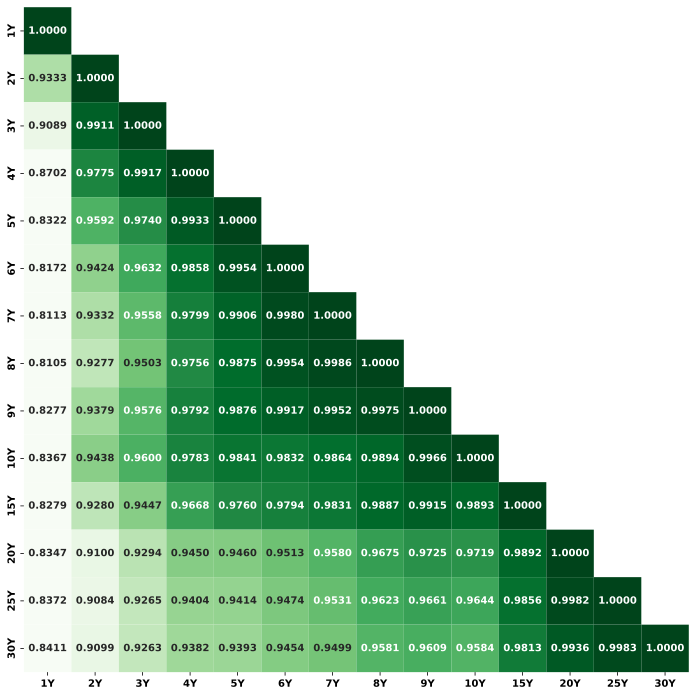

In [28]:
plot_corr_mat(jgb_yields)

### 2.6 Distribution
<a id="subsection-26"></a>

In [29]:
def plot_kde(ts_df) :
    """
    Arguments :
    - ts_df : DataFrame of time series data with daily frequency 
    
    Returns :
    - None 
    
    Function :
    - Draws a kernel density estimation plot of each time series 
    """
    nrows = int(ts_df.shape[1] / 2)
    ncols = 2
    
    fig, ax = plt.subplots(figsize = (12, nrows * 5), nrows = nrows, ncols = ncols)
    if ts_df.shape[1] <= 10 :
        colors = sns.color_palette("tab10")
    else :
        colors = sns.color_palette("tab20")

    for i in range(nrows) :
        for j in range(2) :
            ticker = ts_df.columns[i + i + j]
            color = colors[i + i + j]
            sns.kdeplot(ts_df, x = ticker, color = color, ax = ax[i , j])
        
            # ax[i , j].set_xticks([])
            # ax[i , j].set_yticks([])
        
            ax[i , j].set_xlabel(ticker, fontsize = 12)
            if (i + i + j) % 2 == 0 :
                ax[i , j].set_ylabel("Density", fontsize = 12)
            else :
                ax[i , j].set_ylabel("")
        
            skew = ts_df[ticker].skew( )
            kurt = ts_df[ticker].kurt( )
            ax[i , j].legend([f"skew = {skew.round(2)}\n kurt = {kurt.round(2)}"])

    plt.style.use("default")
    plt.show( )

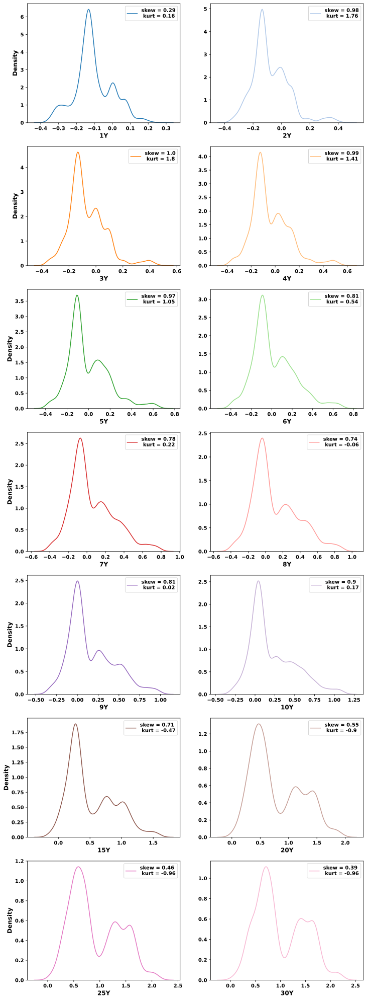

In [30]:
plot_kde(jgb_yields)

In [31]:
def plot_qq(ts_df) :
    """
    Arguments :
    - ts_df : DataFrame of time series data with daily frequency 
    
    Returns :
    - None 
    
    Function :
    - Draws a quantile-quantile plot of each time series 
    """
    nrows = int(ts_df.shape[1] / 2)
    ncols = 2
    
    fig, ax = plt.subplots(figsize = (12, nrows * 5), nrows = nrows, ncols = ncols)
    if ts_df.shape[1] <= 10 :
        colors = sns.color_palette("tab10")
    else :
        colors = sns.color_palette("tab20")

    for i in range(nrows) :
        for j in range(2) :
            ticker = ts_df.columns[i + i + j]
            gofplots.qqplot(ts_df[ticker], line = "q", ax = ax[i , j])
            ax[i , j].get_lines( )[0].set_markersize(5)
            
            ax[i , j].set_xlabel("σ Away From μ", fontsize = 12)
            ax[i , j].set_ylabel(ticker, fontsize = 12)
    
    plt.style.use("default")
    plt.show( )

In [32]:
plot_qq(jgb_yields)

In [33]:
def plot_box_whisker(ts_df, xlabel) : 
    """
    Arguments :
    - ts_df : DataFrame of time series data with daily frequency 
    - xlabel : str for the label to display on the x-axis of the box & whisker plot 
    
    Returns :
    - None 
    
    Function :
    - Draws a box & whisker plot of each time series 
    - Plots outlier values 
    """
    plt.figure(figsize = (12, ts_df.shape[1]))
    if ts_df.shape[1] <= 10 :
        colors = sns.color_palette("tab10")
    else :
        colors = sns.color_palette("tab20")

    for i, ticker in enumerate(ts_df.columns) :
        color = colors[i]
        box = plt.boxplot(ts_df[ticker], positions = [i], widths = 0.5, vert = False, patch_artist = True)

        for patch in box["boxes"] :
            patch.set_facecolor(color)
            patch.set_alpha(0.7)
        for median in box["medians"] :
            median.set_color("black")
    
    # plt.xticks(ticks = np.arange(round(ts_df.min( ).min( ), 1), ts_df.max( ).max( ) + 0.2, 0.2))
    plt.yticks(range(len(ts_df.columns)), ts_df.columns)
    plt.xlabel(xlabel, fontsize = 12)
    plt.style.use("default")
    plt.show( )

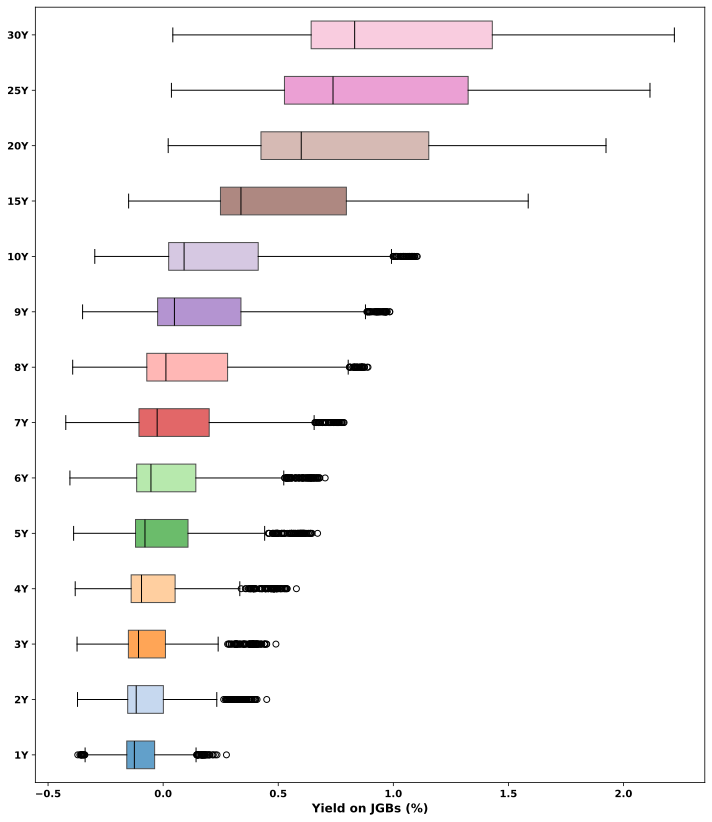

In [34]:
plot_box_whisker(jgb_yields, "Yield on JGBs (%)")

## 3. PCA
<a id="section-3"></a>

### 3.1 Decomposition : Eigen vs Singular Value
<a id="subsection-31"></a>

$$\Sigma = \frac{1}{n-1} Z^T Z$$

$\text{Where :}$
- $\Sigma \text{ is the covariance matrix of the data.}$
- $n \text{ is the number of observations.}$
- $Z \text{ is the standardized data matrix.}$

$$\Sigma = V \Lambda V^{-1}$$

$\text{Where :}$
- $ \Sigma \text{ is the covariance matrix of the data.} $
- $ V \text{ is the matrix of orthogonal eigenvectors, where each column of $V$ is the direction of the corresponding principal component.} $
- $ \Lambda \text{ is the diagonal matrix of eigenvalues, where each diagonal element $\lambda_{i}$ is the variance explained by the corresponding principal component.} $

In [35]:
def conduct_pca(yields_s_df, solver) :
    """
    Arguments :
    - yields_s_df : DataFrame of the standardized yields with daily frequency 
    - solver : str for the method by which to conduct pca 
    
    Returns :
    - fitted_pca : PCA Estimator fitted on the standardized yields 
    - pc_df : DataFrame for the principal components 
    - pc_weights_df : DataFrame for the weights of each feature in each principal component 
    - expl_var_ratio : Series for the explained variance ratio of each principal component 
    - cum_expl_var_ratio : Series for the cumulative explained variance ratio 
    
    Function :
    - Decomposes the standardized yields using the specified solver 
    - Extracts the eigenvectors (principal components), shown as rows 
    - Divides each value by the sum of values in its respective eigenvector (row-wise)
    - Extracts the eigenvalue (explained varance) of each eigenvector 
    - Computes the cumulative sum of the eigenvalues 
    """
    if solver == "covariance_eigh":
        df_to_decomp = cov_mat = np.cov(yields_s_df.T)
    
    elif solver == "full" :
        df_to_decomp = yields_s_df
    
    pca = decomposition.PCA(svd_solver = solver)
    pca.fit(df_to_decomp)
    
    pc_df = pd.DataFrame(pca.components_, columns = yields_s_df.columns)
    pc_weights_df = pc_df.div(pc_df.sum(axis = 1), axis = 0)
    expl_var_ratio = pd.Series(pca.explained_variance_ratio_) 
    cum_expl_var_ratio = pd.Series(pca.explained_variance_ratio_.cumsum( )) 
    
    return pca, pc_df, pc_weights_df, expl_var_ratio, cum_expl_var_ratio

In [36]:
eigen_pcs = conduct_pca(yields_train_s, "covariance_eigh")[1]

In [37]:
eigen_pcs 

,1Y,2Y,3Y,4Y,5Y,6Y,7Y,8Y,9Y,10Y,15Y,20Y,25Y,30Y
0,0.3847,0.1750,-0.0097,-0.1188,-0.1528,-0.2286,-0.2785,-0.3047,-0.2794,-0.2647,-0.2909,-0.3547,-0.3318,-0.3042
1,0.1925,0.3395,0.3439,0.3521,0.3534,0.3419,0.2947,0.2177,0.1650,0.0989,-0.0602,-0.2280,-0.2574,-0.2655
2,0.4189,0.4718,0.3018,0.1591,0.0755,-0.1297,-0.2270,-0.1826,-0.0919,0.0121,0.1864,0.2875,0.3393,0.3700
3,0.4465,0.0716,-0.3265,-0.2610,-0.1032,-0.1820,0.0174,0.1249,0.3191,0.4827,0.3656,0.0831,-0.1134,-0.2700
4,0.4923,-0.2612,0.1865,-0.2177,-0.4119,0.2131,0.3813,0.2040,0.0612,-0.1364,-0.1976,-0.1289,0.0937,0.3441
5,0.3282,-0.4165,-0.3391,0.1426,0.5309,0.2298,-0.1903,-0.1494,-0.0758,-0.0213,0.1663,-0.2848,0.0017,0.2744
6,-0.2065,0.5842,-0.3549,-0.4254,0.0713,0.2231,0.0819,0.0252,-0.0209,0.0511,-0.0693,-0.3207,-0.0047,0.3691
7,-0.1283,-0.0300,0.2790,-0.1456,-0.2025,0.2281,0.1461,-0.3253,-0.1802,-0.1227,0.7431,-0.1946,-0.1499,-0.0573
8,-0.0005,0.1198,-0.4153,0.6436,-0.4703,0.1196,0.1880,-0.2829,-0.0192,0.1503,-0.0265,-0.1155,0.1026,0.0228
9,0.0202,-0.0359,0.0807,-0.1455,-0.1822,0.7108,-0.4802,-0.1062,-0.0262,0.2657,-0.1848,0.2213,0.0519,-0.1826


In [38]:
eigen_pc_weights = conduct_pca(yields_train_s, "covariance_eigh")[2]

In [39]:
eigen_pc_weights 

,1Y,2Y,3Y,4Y,5Y,6Y,7Y,8Y,9Y,10Y,15Y,20Y,25Y,30Y
0,-0.1631,-0.0742,0.0041,0.0504,0.0648,0.0969,0.1180,0.1292,0.1184,0.1122,0.1233,0.1504,0.1407,0.1289
1,0.1019,0.1798,0.1821,0.1865,0.1871,0.1811,0.1560,0.1153,0.0874,0.0524,-0.0319,-0.1207,-0.1363,-0.1406
2,0.2104,0.2369,0.1516,0.0799,0.0379,-0.0652,-0.1140,-0.0917,-0.0461,0.0061,0.0936,0.1444,0.1704,0.1858
3,0.6820,0.1093,-0.4987,-0.3987,-0.1576,-0.2781,0.0266,0.1908,0.4874,0.7374,0.5585,0.1270,-0.1733,-0.4125
4,0.7907,-0.4196,0.2996,-0.3496,-0.6616,0.3423,0.6125,0.3277,0.0983,-0.2191,-0.3173,-0.2071,0.1506,0.5527
5,1.6682,-2.1169,-1.7237,0.7249,2.6988,1.1683,-0.9675,-0.7596,-0.3851,-0.1081,0.8452,-1.4478,0.0089,1.3945
6,-59.8913,169.4794,-102.9554,-123.4019,20.6923,64.7081,23.7455,7.3059,-6.0574,14.8344,-20.1109,-93.0466,-1.3727,107.0704
7,0.9161,0.2144,-1.9917,1.0392,1.4457,-1.6284,-1.0428,2.3218,1.2862,0.8761,-5.3048,1.3891,1.0700,0.4091
8,-0.0296,7.2261,-25.0508,38.8194,-28.3697,7.2133,11.3384,-17.0647,-1.1556,9.0678,-1.5981,-6.9637,6.1904,1.3769
9,2.9217,-5.1954,11.6574,-21.0259,-26.3328,102.7355,-69.4022,-15.3509,-3.7906,38.4011,-26.7147,31.9814,7.5051,-26.3897


$$Z = U \Sigma V^T$$

$\text{Where :}$
- $Z \text{ is the standardized data matrix.}$
- $ U \text{ is an $n \times n$ orthogonal matrix (left singular vectors).} $
- $ \Sigma \text{ is an $n \times p$ diagonal matrix with non-negative real numbers on the diagonal (singular values).} $
- $ V \text{ is a $p \times p$ orthogonal matrix (right singular vectors), where each column is a principal component.} $

In [40]:
svd_pcs = conduct_pca(yields_train_s, "full")[1]

In [41]:
svd_pcs

,1Y,2Y,3Y,4Y,5Y,6Y,7Y,8Y,9Y,10Y,15Y,20Y,25Y,30Y
0,0.2518,0.2635,0.2685,0.2698,0.2699,0.2695,0.2693,0.2699,0.2707,0.2705,0.2696,0.2665,0.2661,0.2655
1,0.6184,0.4432,0.2436,0.1266,0.0892,0.0002,-0.0701,-0.1217,-0.1090,-0.1123,-0.1893,-0.3123,-0.2964,-0.2691
2,0.4470,0.0971,-0.0907,-0.2121,-0.2517,-0.3295,-0.3262,-0.2504,-0.1515,-0.0458,0.1393,0.2887,0.3481,0.3839
3,-0.3802,0.1529,0.4218,0.3259,0.1587,0.0828,-0.1437,-0.2098,-0.3228,-0.4004,-0.2279,0.0295,0.1909,0.3121
4,-0.3618,0.4219,0.0190,0.1101,0.1833,-0.3256,-0.3509,-0.2016,0.0509,0.3206,0.3667,0.1572,-0.0903,-0.3201
5,0.1780,-0.3181,-0.4073,0.2042,0.6373,0.1632,-0.2845,-0.1861,-0.0959,-0.0003,0.1856,-0.2108,-0.0149,0.1514
6,-0.2092,0.5873,-0.3567,-0.4244,0.0723,0.2214,0.0811,0.0259,-0.0212,0.0507,-0.0711,-0.3172,-0.0043,0.3656
7,-0.0388,-0.1989,0.4432,-0.1512,-0.2177,0.1105,0.0352,-0.2709,-0.0070,0.1323,0.5459,-0.4520,-0.1743,0.2349
8,0.0217,0.1482,-0.2401,0.0310,-0.1435,0.3559,0.2638,-0.1460,-0.2749,-0.4580,0.4893,0.2260,0.0519,-0.3199
9,-0.0212,0.0811,-0.3389,0.6461,-0.4587,0.0355,0.1370,-0.2840,0.0393,0.2828,-0.1099,-0.1956,0.0768,0.1086


In [42]:
svd_pc_weights = conduct_pca(yields_train_s, "full")[2]

In [43]:
svd_pc_weights

,1Y,2Y,3Y,4Y,5Y,6Y,7Y,8Y,9Y,10Y,15Y,20Y,25Y,30Y
0,0.0673,0.0704,0.0718,0.0721,0.0722,0.0720,0.0720,0.0721,0.0723,0.0723,0.0721,0.0712,0.0711,0.0710
1,15.1653,10.8690,5.9740,3.1045,2.1864,0.0042,-1.7181,-2.9855,-2.6742,-2.7550,-4.6435,-7.6585,-7.2697,-6.5989
2,9.6934,2.1054,-1.9671,-4.5990,-5.4583,-7.1453,-7.0739,-5.4299,-3.2857,-0.9933,3.0199,6.2610,7.5487,8.3241
3,37.6484,-15.1452,-41.7692,-32.2742,-15.7154,-8.2018,14.2342,20.7708,31.9700,39.6515,22.5647,-2.9231,-18.9044,-30.9063
4,17.6736,-20.6058,-0.9300,-5.3795,-8.9550,15.9045,17.1404,9.8478,-2.4869,-15.6611,-17.9123,-7.6773,4.4089,15.6330
5,93.8358,-167.6862,-214.7179,107.6366,335.9775,86.0445,-149.9816,-98.0963,-50.5314,-0.1706,97.8283,-111.1315,-7.8324,79.8254
6,-2322.5485,6519.5822,-3959.7048,-4710.8805,802.2457,2457.8486,900.3261,287.5742,-235.2755,562.3283,-789.5896,-3521.3479,-48.2652,4058.7068
7,4.3897,22.5208,-50.1929,17.1221,24.6566,-12.5135,-3.9819,30.6724,0.7982,-14.9782,-61.8121,51.1868,19.7357,-26.6037
8,3.9740,27.1090,-43.9115,5.6661,-26.2496,65.0799,48.2315,-26.6924,-50.2630,-83.7471,89.4691,41.3351,9.4941,-58.4952
9,17.8894,-68.4132,285.9596,-545.0892,387.0059,-29.9929,-115.6234,239.6195,-33.1412,-238.5945,92.7539,165.0445,-64.7966,-91.6217


### 3.2 Explained Variance
<a id="subsection-32"></a>

$$\text{Explained Variance}_{i\in p} = \lambda_i$$

$$\text{Total Explained Variance} = \sum_{i=1}^{p} \lambda_i$$

$$\text{Explained Variance Ratio}_i = \frac{\lambda_i}{\sum_{j=1}^{p} \lambda_j}$$

$\text{Where :}$
- $\lambda_{i} \text{is the eigenvalue corresponding to the \(i\)-th principal component.} $
- $ p \text{ is the number of features in the original data.} $

In [44]:
eigen_expl_var_ratio = conduct_pca(yields_train_s, "covariance_eigh")[3] 
eigen_cum_expl_var_ratio = conduct_pca(yields_train_s, "covariance_eigh")[4] 

In [45]:
def plot_explained_var(expl_var_ratio, cum_expl_var_ratio, xlabel) :
    """
    Arguments :
    - expl_var_ratio : Series for the explained variance ratio of each principal component 
    - cum_expl_var_ratio : Series for the cumulative explained variance ratio 
    - xlabel : str for the label on the x-axis of the explained variance and cumulative explained variance ratio plots 
    
    Returns :
    - None 
    
    Function :
    - Draws a bar chart of the eigenvalue of each eigenvector   
    - Draws a line plot for the cumulative sum of the eigenvalues 
    """    
    fig, ax = plt.subplots(figsize = (12, 14), nrows = 2, ncols = 1)
    
    ax[0].bar(x = expl_var_ratio.index, height = expl_var_ratio.mul(100), width = 0.5, color = "purple", alpha = 0.7)
    ax[0].set_xticks(ticks = expl_var_ratio.index)
    ax[0].set_yticks(ticks = range(0, 101, 10))
    
    ax[0].set_xlabel(xlabel = xlabel, fontsize = 12)
    ax[0].set_ylabel(ylabel = "Explained Variance Ratio (%)", fontsize = 12) 
    
    ax[1].plot(cum_expl_var_ratio.mul(100), marker = "o", color = "purple", alpha = 0.7)

    ax[1].hlines(y = cum_expl_var_ratio.iloc[2] * 100, 
                 xmin = 0, xmax = 2, color = "black", linestyle = "dashed")
    ax[1].vlines(x = 2, ymin = cum_expl_var_ratio.iloc[0] * 100, 
                 ymax = cum_expl_var_ratio.iloc[2] * 100, color = "black", linestyle = "dashed")

    ax[1].set_xticks(ticks = expl_var_ratio.index)
    ax[1].set_xlabel(xlabel = xlabel, fontsize = 12) 
    ax[1].set_ylabel(ylabel = "Cumulative Explained Variance Ratio (%)", fontsize = 12)  
    
    plt.style.use("default")
    plt.show( ) 

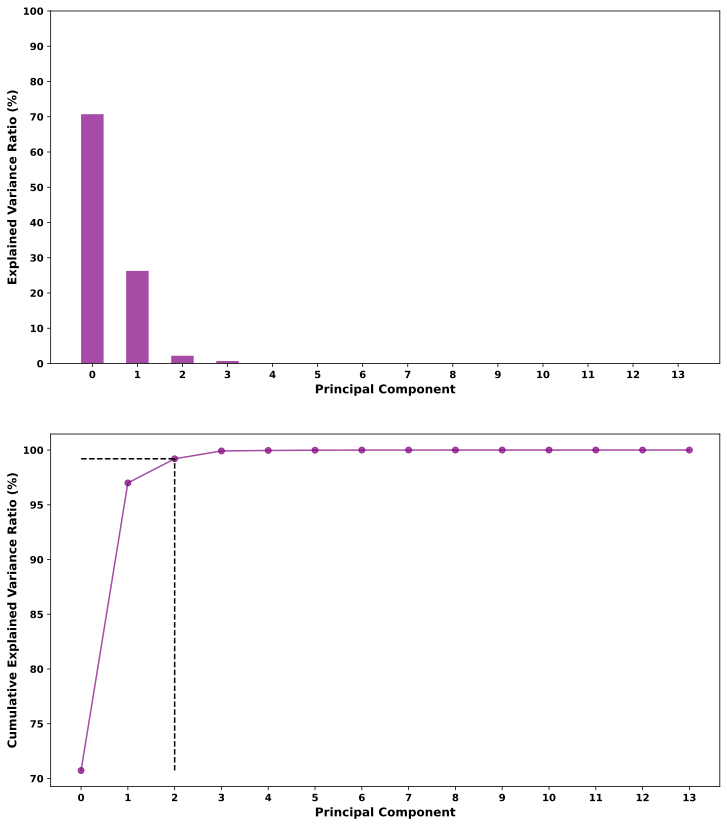

In [46]:
plot_explained_var(eigen_expl_var_ratio, eigen_cum_expl_var_ratio, "Principal Component")

$$\text{Explained Variance}_{i \in p} = \frac{\sigma_i^2}{n-1}$$

$$\text{Total Explained Variance} = \sum_{i=1}^{p} \frac{\sigma_i^2}{n-1}$$

$$\text{Explained Variance Ratio}_i = \frac{\sigma_i^2}{\sum_{j=1}^{p} \sigma_j^2}$$

$\text{Where :}$
- $ \sigma_i \text{ is the $k$-th singular value of the diagonal matrix.} $
- $ n \text{ is the number of observations.} $
- $ p \text{ is the number of features in the original data.} $
- $ \sigma_i^2 \text{ is the variance of the \(j\)-th feature.} $

In [47]:
svd_expl_var_ratio = conduct_pca(yields_train_s, "full")[3] 
svd_cum_expl_var_ratio = conduct_pca(yields_train_s, "full")[4] 

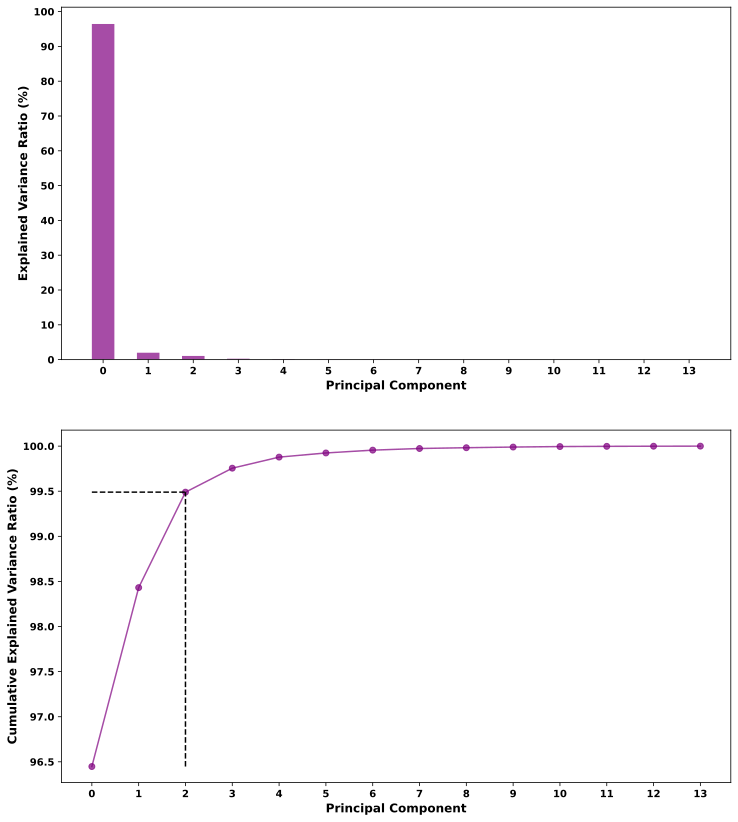

In [48]:
plot_explained_var(svd_expl_var_ratio, svd_cum_expl_var_ratio, "Principal Component")

### 3.3 Top 3 Components : Level, Slope & Curvature
<a id="subsection-33"></a>

**Principal Component 1**

- This eigenvector consists only of positive values, with all tenors weighted in the same direction
- It reflects movements that cause all maturities to move in the same direction, shifting the entire yield curve up or down
- These correspond to directional movements in the yield curve

**Principal Component 2**

- This eigenvector has the first half of the components negative and the second half positive
- Treasury rates on the short end of the curve are weighted positively, while those on the long end are weighted negatively
- It reflects movements that cause the short end to go in one direction and the long end in the other
- These correspond to slope movements in the yield curve

**Principal Component 3**

- This eigenvector has the first third of the components negative, the second third positive, and the last third negative
- It reflects movements that cause the short and long ends of the curve to go in one direction, and the middle end to go in the other direction
- These correspond to curvature movements of the yield curve

In [49]:
def extract_top3_pcs(pc_df, pc_weights_df) :
    """
    Arguments :
    - pc_df : DataFrame for the principal components 
    - pc_weights_df : DataFrame for the weights of each feature in each principal component 
    
    Returns :
    - top3_pcs_df : DataFrame for the top 3 principal components 
    - top3_pcs_weights_df : DataFrame for the weights of each feature in each of the top 3 principal components   
    
    Function :
    - Filters the specified eigenvectors DataFrame to keep only the first 3 rows 
    - Filters the specified eigenvector weights DataFrame to keep only the first 3 rows 
    - Draws a bar plot of the weights of each feature for each of the top 3 eigenvectors  
    - Draws a line plot of each of the top 3 eigenvectors 
    """   
    top3_pcs_df = pc_df.iloc[:3].copy( )
    top3_pcs_weights_df = pc_weights_df.iloc[:3].copy( )
    
    top3_pcs_weights_df.T.plot(kind = "bar", figsize = (12, 3 * 5), fontsize = 10, subplots = True, layout = (3, 1), 
                               sharex = False, sharey = False, legend = False, rot = 0, 
                               title = [f"Principal Component {i}" for i in range(3)], ylabel = "Weights (%)") 

    plt.style.use("default")
    plt.show( )
    
    plt.figure(figsize = (12, 5))
    plt.plot(top3_pcs_df.T, label = ["Level", "Slope", "Curvature"], marker = "s")
    
    plt.title("Yield Curve Factors", fontsize = 12)
    plt.yticks(ticks = np.arange(round(top3_pcs_df.min( ).min( ), 1), top3_pcs_df.max( ).max( ) + 0.1, 0.2))
    plt.legend(loc = "best")
    plt.style.use("default")
    plt.show( )
    
    return top3_pcs_df, top3_pcs_weights_df 

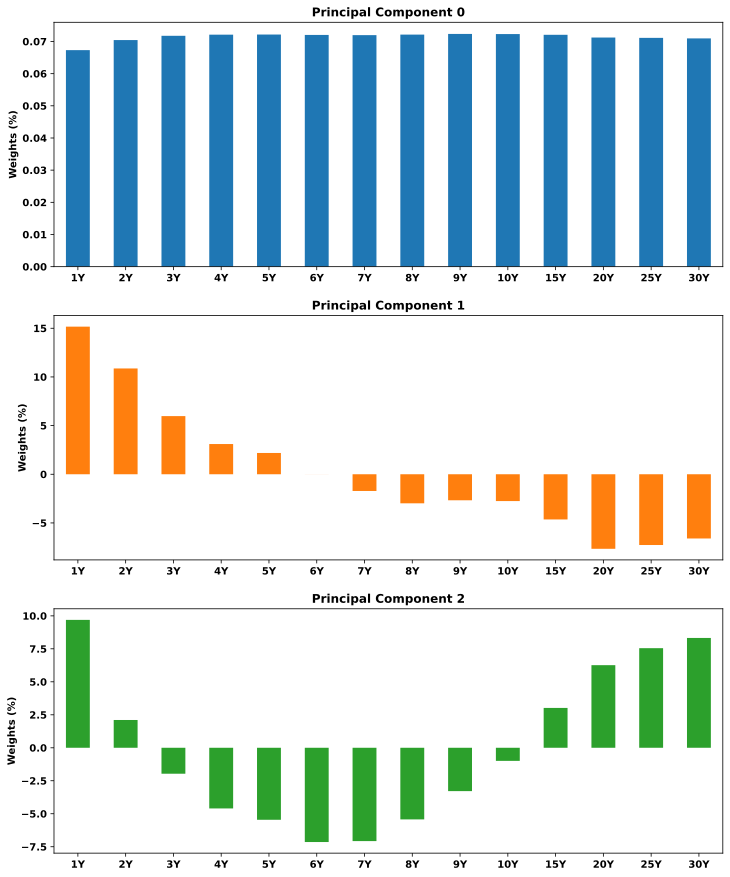

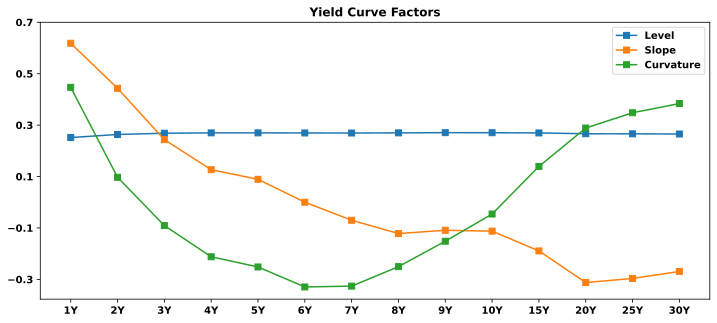

In [50]:
svd_top3_pcs, svd_top3_weights = extract_top3_pcs(svd_pcs, svd_pc_weights)

### 3.4 Yield Curve Reconstruction : Variance Retained?
<a id="subsection-34"></a>

1. **Dimensionality Reduction**
> Project the data onto principal components to form a score matrix :
$T = ZV_k$. Each row of $T$ represents the scores of the corresponding observation in the $k$-dimensional space. These scores indicate how much the observation contributes to each of the principal components.

In [51]:
svd_pca = conduct_pca(yields_train_s, solver = "full")[0]

In [52]:
def reduce_dimensionality(fitted_pca, yields_s_df) :
    """
    Arguments :
    - fitted_pca : PCA Estimator fitted on the standardized yields 
    - yields_s_df : DataFrame for the standardized yields with daily frequency 
    
    Returns :
    - pc_scores_df : DataFrame for the projected data onto the top 3 principal components 
    
    Function :
    - Multiplies the standardized yields by the top 3 eigenvectors 
    """  
    pc_scores_df = pd.DataFrame(fitted_pca.transform(yields_s_df), index = yields_s_df.index).iloc[:, :3]
    pc_scores_df.columns = ["Level", "Slope", "Curvature"]
    return pc_scores_df 

In [53]:
svd_pc_scores_train = reduce_dimensionality(svd_pca, yields_train_s)
svd_pc_scores_test = reduce_dimensionality(svd_pca, yields_test_s)
svd_pc_scores = pd.concat(objs = [svd_pc_scores_train, svd_pc_scores_test], axis = 0, ignore_index = False)

In [54]:
svd_pc_scores

,Level,Slope,Curvature
Date,,,
2014-01-01,8.8584,-0.3854,-0.7661
2014-01-02,8.8584,-0.3854,-0.7661
2014-01-03,8.8584,-0.3854,-0.7661
2014-01-06,8.6763,-0.3869,-0.6875
2014-01-07,8.4090,-0.3148,-0.5574
...,...,...,...
2024-07-25,15.5079,1.2379,-2.5342
2024-07-26,15.4150,1.3281,-2.5218
2024-07-29,14.9657,1.2640,-2.3720


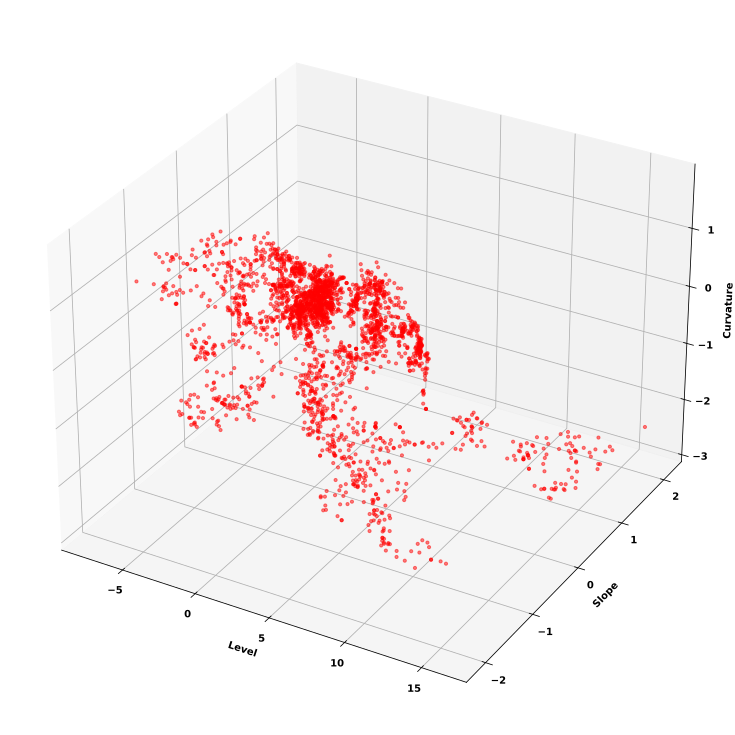

In [55]:
fig = plt.figure(figsize = (13, 13))
ax = fig.add_subplot(111, projection = "3d")
ax.scatter(svd_pc_scores["Level"], svd_pc_scores["Slope"], svd_pc_scores["Curvature"], s = 10, c = "red", alpha = 0.5)

ax.set_xlabel("Level")
ax.set_ylabel("Slope")
ax.set_zlabel("Curvature")

plt.style.use("default")
plt.show( )

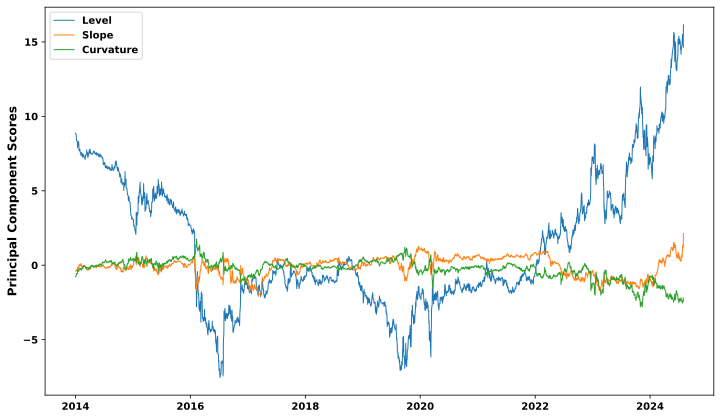

In [56]:
plot_time_series(svd_pc_scores, ylabel = "Principal Component Scores")

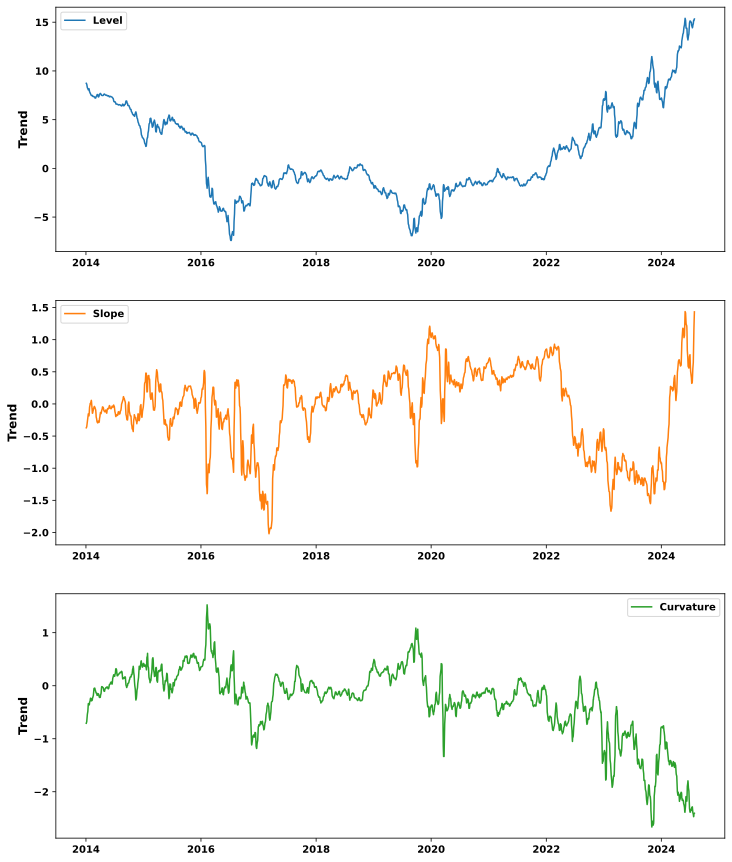

In [57]:
plot_seasonal_decomp(svd_pc_scores, component = "trend")

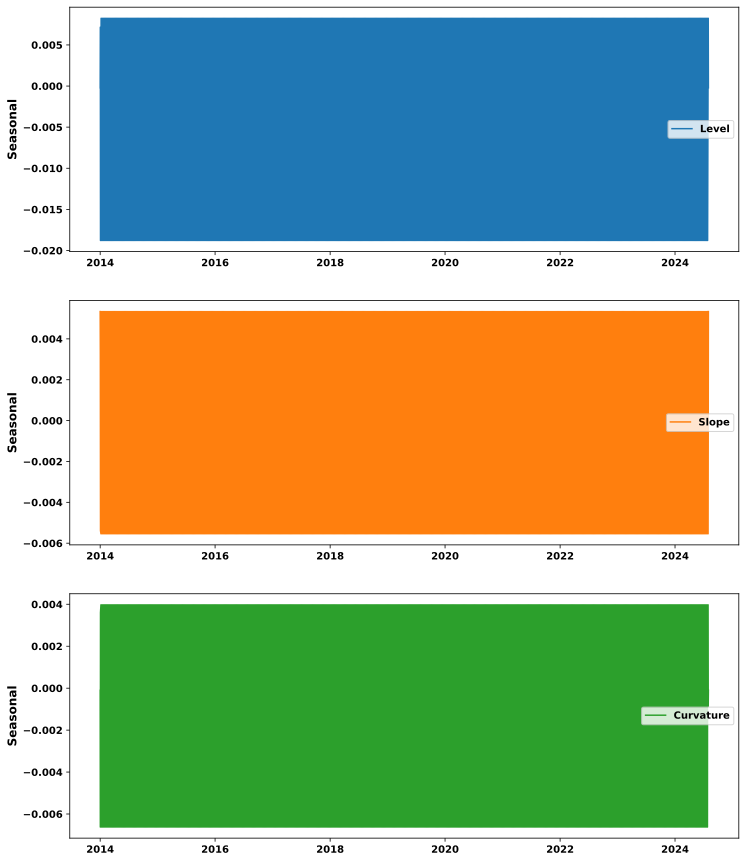

In [58]:
plot_seasonal_decomp(svd_pc_scores, component = "seasonal")

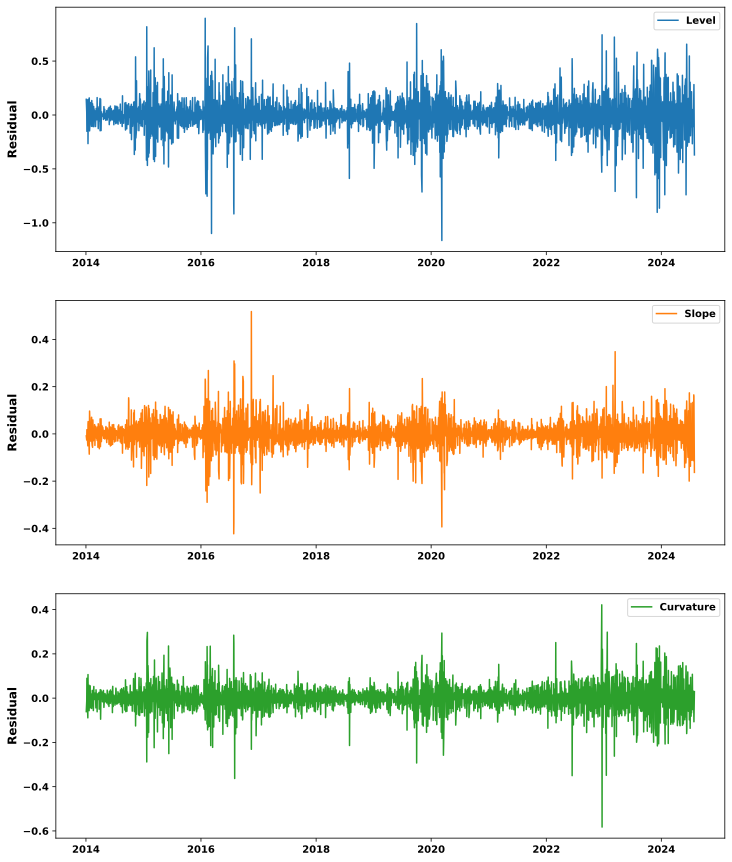

In [59]:
plot_seasonal_decomp(svd_pc_scores, component = "residual")

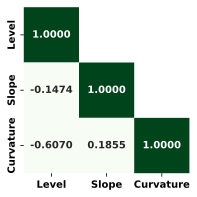

In [60]:
plot_corr_mat(svd_pc_scores)

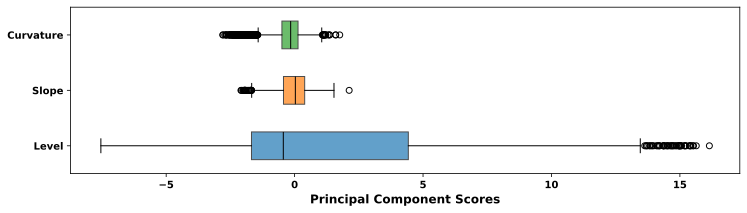

In [61]:
plot_box_whisker(svd_pc_scores, xlabel = "Principal Component Scores")

2. **Data Reconstruction**
> Reconstruct the data from the reduced score and right singular vector matrices, using only the first $k$ principal components : $\hat{Z}_k = T_k V_k^T.$

In [62]:
std_scaler = z_score_normalize(yields_train, yields_test)[0]

In [63]:
def pca_reconstruct(fitted_scaler, fitted_pca, yields_s_df) : 
    """
    Arguments :
    - fitted_scaler : StandardScaler Estimator fitted on the unscaled yields 
    - fitted_pca : PCA Estimator fitted on the standardized yields 
    - yields_s_df : DataFrame for the standardized yields with daily frequency  
    
    Returns :
    - reconstr_yields_df : DataFrame for the unscaled, reconstructed yields  
    
    Function :
    - Computes the dot product of the projected data (onto the top 3 eigenvectors) and the top 3 eigenvectors 
    - Inverse standardizes the resulting reconstructed yields 
    """  
    reconstr_yields_s_df = pd.DataFrame(np.dot(fitted_pca.transform(yields_s_df)[:, :3], fitted_pca.components_[:3]),
                                        index = yields_s_df.index, columns = yields_s_df.columns)
    reconstr_yields_df = pd.DataFrame(fitted_scaler.inverse_transform(reconstr_yields_s_df), 
                                      index = yields_s_df.index, columns = yields_s_df.columns)
    return reconstr_yields_df 

In [64]:
svd_yields_train = pca_reconstruct(std_scaler, svd_pca, yields_train_s)
svd_yields_test = pca_reconstruct(std_scaler, svd_pca, yields_test_s)
svd_yields = pd.concat(objs = [svd_yields_train, svd_yields_test], axis = 0, ignore_index = False)

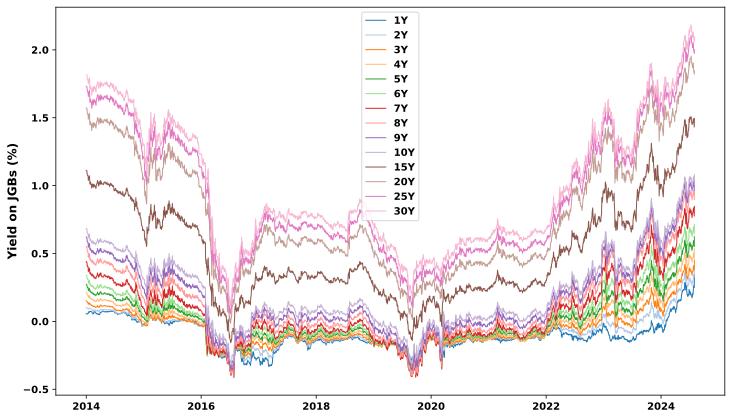

In [65]:
plot_time_series(svd_yields, ylabel = "Yield on JGBs (%)")

$$R^2 = 1 - \frac{\sum_{i=1}^{n} (y_i - \hat{y_i})^2}{\sum_{i=1}^{n} (y_i - \bar{y})^2}$$
   
$\text{Where :}$
- $ y_i \text{ is the observed actual outcome for the $i$-th observation.} $
- $ \hat{y_i} \text{ is the predicted outcome for the $i$-th observation.} $
- $ \bar{y} \text{ is the mean of the observed values.} $

$$\text{Adjusted } R^2 = 1 - \left( \frac{(1 - R^2)(n - 1)}{n - p - 1} \right)$$

$\text{Where :}$
- $ n \text{ is the number of observations.} $
- $ p \text{ is the number of features.} $

In [66]:
def eval_fit(obs_yields_df, reconstr_yields_df) :
    """
    Arguments :
    - obs_yields_df : DataFrame for the unscaled, original yields with daily frequency 
    - reconstr_yields_df : DataFrame for the unscaled, reconstructed yields with daily frequency 
    
    Returns :
    - None 
    
    Function :
    - Computes the r-squared and adjusted r-squared of the reconstructed yields 
    - Draws a line plot of the original and reconstructed yields together for each maturity 
    """    
    fig, ax = plt.subplots(nrows = 14, ncols = 1, figsize = (12, 75))
    colors = sns.color_palette("tab20")
    
    perf_metrics = { }
    for i, ticker in enumerate(obs_yields_df.columns) :
        
        r2 = metrics.r2_score(obs_yields_df[ticker], reconstr_yields_df[ticker])
        adj_r2 = 1 - ((1 - r2) * (len(obs_yields_df) - 1) / (len(obs_yields_df) - len(obs_yields_df.columns) - 1))
        perf_metrics[ticker] = [r2, adj_r2]
        
        ax[i].plot(obs_yields_df[ticker], color = colors[i], label = ticker, linewidth = 2.5)
        ax[i].plot(reconstr_yields_df[ticker], color = "black", alpha = 0.5, label = f"{ticker} Reconstructed")
        ax[i].set_ylabel("Yield (%)", fontsize = 12)
        ax[i].legend( )
    
    perf_metrics_df = pd.DataFrame(perf_metrics, index = ["R^2", "Adjusted R^2"]).T    
    print(perf_metrics_df * 100)
    
    plt.style.use("default") 
    plt.show( )

        R^2  Adjusted R^2
1Y  99.1973       99.1914
2Y  99.3775       99.3730
3Y  99.1049       99.0984
4Y  99.4262       99.4220
5Y  99.5429       99.5396
6Y  99.6979       99.6957
7Y  99.6186       99.6158
8Y  99.6995       99.6973
9Y  99.5806       99.5776
10Y 99.1743       99.1683
15Y 99.4404       99.4363
20Y 99.8116       99.8102
25Y 99.8304       99.8291
30Y 99.3558       99.3511


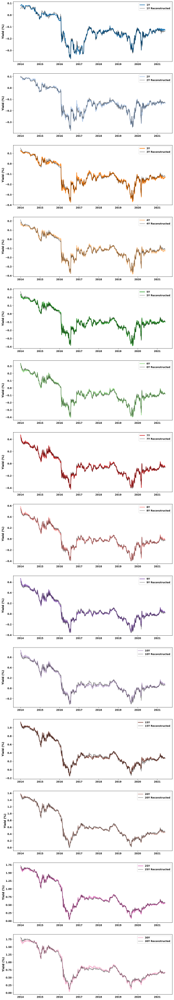

In [67]:
eval_fit(yields_train, svd_yields_train)

        R^2  Adjusted R^2
1Y  92.2705       92.1375
2Y  97.3645       97.3191
3Y  96.9636       96.9114
4Y  98.6281       98.6046
5Y  98.1286       98.0965
6Y  99.2826       99.2702
7Y  98.9110       98.8923
8Y  98.6776       98.6548
9Y  99.0713       99.0554
10Y 97.3216       97.2755
15Y 98.3266       98.2979
20Y 99.1298       99.1148
25Y 99.7367       99.7322
30Y 98.8802       98.8609


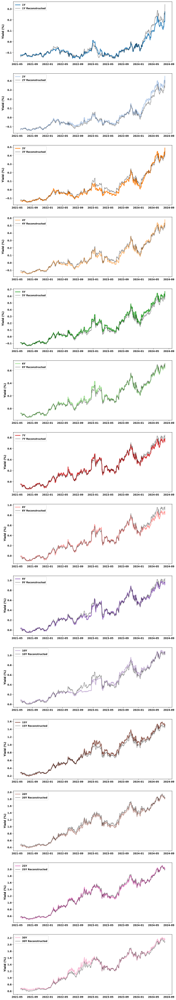

In [68]:
eval_fit(yields_test, svd_yields_test)

## 4. Factor Analysis 
<a id="section-4"></a>

### 4.1 Single Value Decomposition 
<a id="subsection-41"></a>

$$\Sigma = \Lambda \Phi \Lambda^T + \Psi$$

$\text{Where :}$
- $\Sigma \text{ is the covariance matrix of the data.}$
- $ \Lambda \text{ is the matrix of factor loadings.} $
- $ \Phi \text{ is the covariance matrix of the latent factors (typically the identity matrix \( I_k \) if factors are assumed to be uncorrelated).} $
- $ \Psi \text{ is the diagonal matrix of unique variances (i.e., $\text{diag}(\psi_1, \psi_2, \dots, \psi_p)$).} $

In [69]:
def conduct_fa(yields_s_df) :
    """
    Arguments :
    - yields_s_df : DataFrame of the standardized yields with daily frequency 
    
    Returns :
    - fitted_fa : FactorAnalysis Estimator fitted on the standardized yields 
    - factor_loadings_df : DataFrame for the factor loadings 
    - expl_var_ratio : Series for the explained variance ratio of each latent factor 
    - cum_expl_var_ratio : Series for the cumulative explained variance ratio 
    
    Function :
    - Decomposes the standardized yields 
    - Extracts the factor loadings, shown as rows 
    - Computes the sum of squared factor loadings (column-wise)
    - Divides the sum of squared factor loadings by the total variance (column-wise)
    - Computes the cumulative sum of the eigenvalues 
    """
    fa = decomposition.FactorAnalysis( )  
    fa.fit(yields_s_df)
    
    factor_loadings_df = pd.DataFrame(fa.components_, columns = yields_s_df.columns)
    expl_var = np.sum(fa.components_ ** 2, axis = 1) 
    
    expl_var = np.sum(fa.components_.T ** 2, axis = 0)
    total_var = yields_s_df.var(axis = 0).sum( )  

    expl_var_ratio = pd.Series(expl_var / total_var)
    cum_expl_var_ratio = pd.Series(expl_var_ratio.cumsum( ))
    
    return fa, factor_loadings_df, expl_var_ratio, cum_expl_var_ratio

In [70]:
factor_loadings = conduct_fa(yields_train_s)[1]

In [71]:
factor_loadings 

,1Y,2Y,3Y,4Y,5Y,6Y,7Y,8Y,9Y,10Y,15Y,20Y,25Y,30Y
0,0.9147,0.9610,0.9815,0.9880,0.9889,0.9884,0.9879,0.9902,0.9923,0.9912,0.9875,0.9758,0.9738,0.9712
1,-0.1896,-0.1613,-0.1068,-0.0731,-0.0609,-0.0335,-0.0052,0.0204,0.0249,0.0353,0.0766,0.1310,0.1286,0.1204
2,-0.1117,-0.0536,-0.0127,0.0144,0.0241,0.0440,0.0497,0.0413,0.0251,0.0086,-0.0168,-0.0335,-0.0442,-0.0517
3,-0.0000,-0.0000,0.0000,0.0000,0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,0.0000,0.0000
4,-0.0000,0.0000,0.0000,0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,0.0000,0.0000,-0.0000,-0.0000
5,0.0000,-0.0000,-0.0000,0.0000,0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,0.0000,0.0000
6,0.0000,-0.0000,0.0000,0.0000,-0.0000,-0.0000,-0.0000,-0.0000,0.0000,-0.0000,0.0000,0.0000,-0.0000,-0.0000
7,-0.0000,-0.0000,0.0000,-0.0000,-0.0000,0.0000,0.0000,-0.0000,-0.0000,0.0000,0.0000,-0.0000,-0.0000,0.0000
8,-0.0000,-0.0000,0.0000,-0.0000,0.0000,-0.0000,-0.0000,0.0000,0.0000,0.0000,-0.0000,-0.0000,-0.0000,0.0000
9,-0.0000,0.0000,-0.0000,0.0000,-0.0000,0.0000,0.0000,-0.0000,0.0000,0.0000,-0.0000,-0.0000,0.0000,0.0000


### 4.2 Explained Variance
<a id="subsection-42"></a>

$$\text{Explained Variance}_{i\in p} = \sum_{j=1}^{m} (\lambda_{ji})^2$$ 

$$\text{Total Explained Variance} = \sum_{i=1}^{n} \sum_{j=1}^{m} (\lambda_{ji})^2$$

$$\text{Explained Variance Ratio}_i = \frac{\sum_{j=1}^{m} (\lambda_{ji})^2}{\sum_{j=1}^{m} \sigma_j^2}$$

$\text{Where :}$

- $ n \text{ is the number of factors.} $
- $ m \text{ is the number of observed variables.} $
- $ \lambda_{ji} \text{ represents the loading of the \(i\)-th factor on the \(j\)-th observed variable.} $
- $ \sigma_j^2 \text{ is the variance of the \(j\)-th observed variable.} $

In [72]:
fa_expl_var_ratio = conduct_fa(yields_train_s)[2] 
fa_cum_expl_var_ratio = conduct_fa(yields_train_s)[3] 

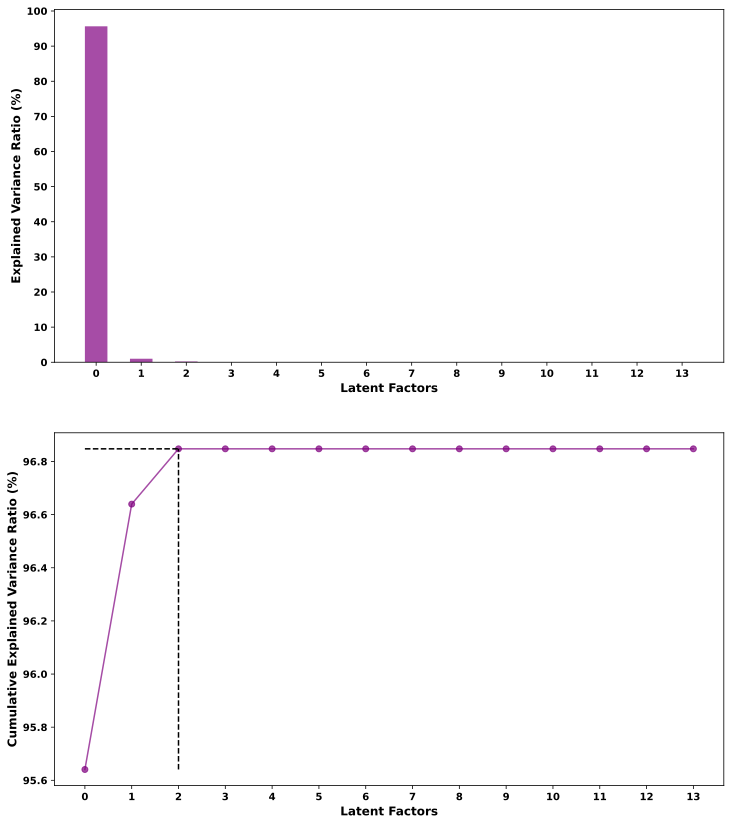

In [73]:
plot_explained_var(fa_expl_var_ratio, fa_cum_expl_var_ratio, "Latent Factors")

### 4.3 Top 3 Latent Factors : Level, Slope & Curvature 
<a id="subsection-43"></a>

**Latent Factor 1**

- This latent factor consists only of positive loadings, consistent across all tenors 
- It reflects movements that cause all maturities to move in the same direction, shifting the entire yield curve up or down
- These correspond to directional movements in the yield curve

**Latent Factor 2**

- This latent factor has the first half of the loadings negative and the second half positive
- Treasury rates on the short end of the curve have negative loadings, while those on the long end have positive loadings 
- It reflects movements that cause the short end to go in one direction and the long end in the other
- These correspond to slope movements in the yield curve

**Latent Factor 3**

- This latent factor has the first third of the loadings negative, the second third positive, and the last third negative
- It reflects movements that cause the short and long ends of the curve to go in one direction, and the middle end to go in the other direction
- These correspond to curvature movements of the yield curve

In [74]:
def extract_top3_factors(factor_loadings_df) :
    """
    Arguments :
    - factor_loadings_df 
    
    Returns :
    - top3_factor_loadings_df_weights : DataFrame for the loadings of each feature in each of the top 3 factors    
    
    Function :
    - Filters the specified loadings DataFrame to keep only the first 3 rows 
    - Draws a bar plot of the loadings of each feature for each of the top 3 factors   
    """   
    top3_factor_loadings_df = factor_loadings_df.iloc[:3].copy( )
    
    top3_factor_loadings_df.T.plot(kind = "bar", figsize = (12, 3 * 5), fontsize = 10, subplots = True, layout = (3, 1), 
                                   sharex = False, sharey = False, legend = False, rot = 0, 
                                   title = [f"Latent Factor {i}" for i in range(3)], ylabel = "Loadings") 
    plt.style.use("default")
    plt.show( )

    return top3_factor_loadings_df  

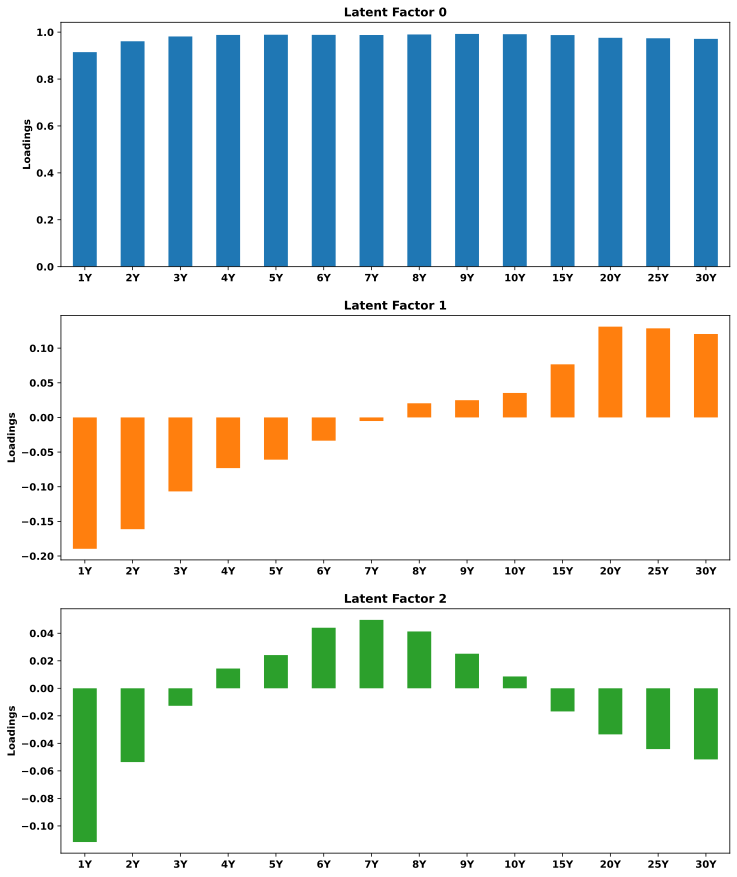

In [75]:
top3_factors_loadings = extract_top3_factors(factor_loadings)

### 4.4 Yield Curve Reconstruction : Variance Retained?
<a id="subsection-44"></a>

1. **Dimensionality Reduction**
> Project the data onto latent factors to form a score matrix :
$\hat{F} = (\Lambda^T \Lambda)^{-1} \Lambda^T Z$. These scores indicate how much the observation contributes to each latent factor, with their magnitude indicating the strength of relationship with that factor. A positive factor score indicates that the observation has a higher than average contribution to that factor.A negative score indicates a lower than average contribution.

In [76]:
fa = conduct_fa(yields_train_s)[0]

In [77]:
def reduce_dimensionality(fitted_fa, yields_s_df) :

    fa_scores_df = pd.DataFrame(fitted_fa.transform(yields_s_df)[:, :3], index = yields_s_df.index)
    fa_scores_df.columns = ["Level", "Slope", "Curvature"]
    return fa_scores_df 

In [78]:
fa_scores_train = reduce_dimensionality(fa, yields_train_s)
fa_scores_test = reduce_dimensionality(fa, yields_test_s)
fa_scores = pd.concat(objs = [fa_scores_train, fa_scores_test], axis = 0, ignore_index = False)

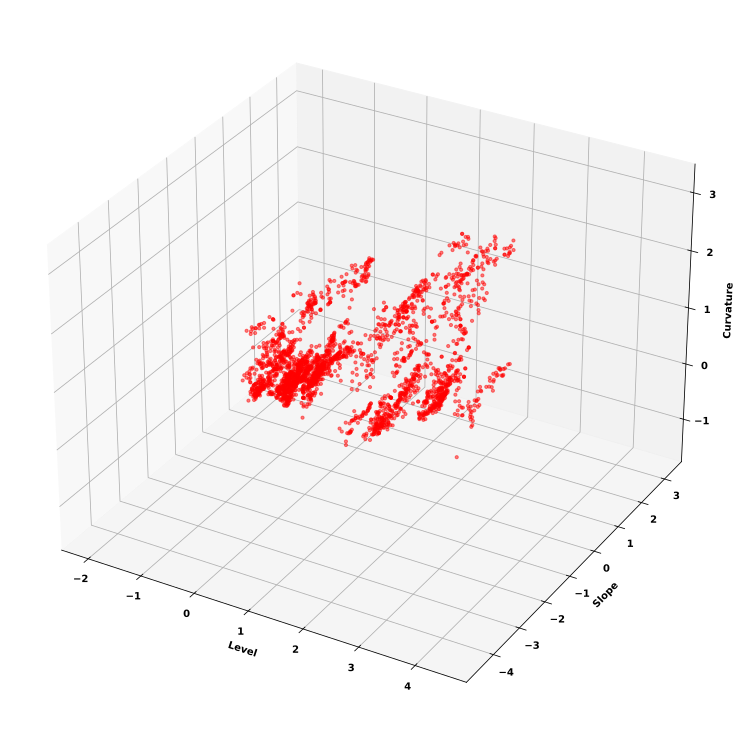

In [79]:
fig = plt.figure(figsize = (13, 13))
ax = fig.add_subplot(111, projection = "3d")
ax.scatter(fa_scores["Level"], fa_scores["Slope"], fa_scores["Curvature"], s = 10, c = "red", alpha = 0.5)

ax.set_xlabel("Level")
ax.set_ylabel("Slope")
ax.set_zlabel("Curvature")

plt.style.use("default")
plt.show( )

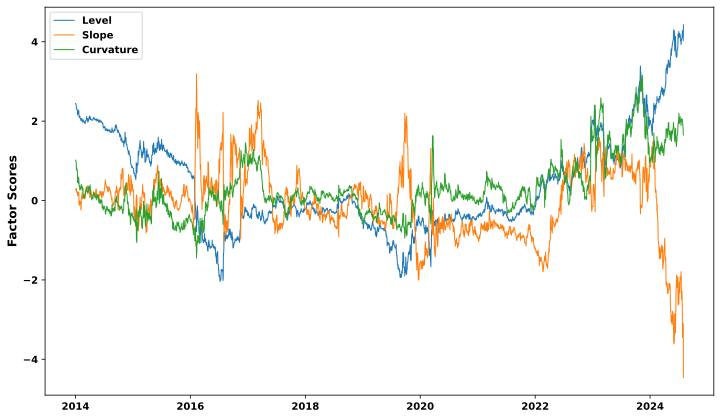

In [80]:
plot_time_series(fa_scores, ylabel = "Factor Scores")

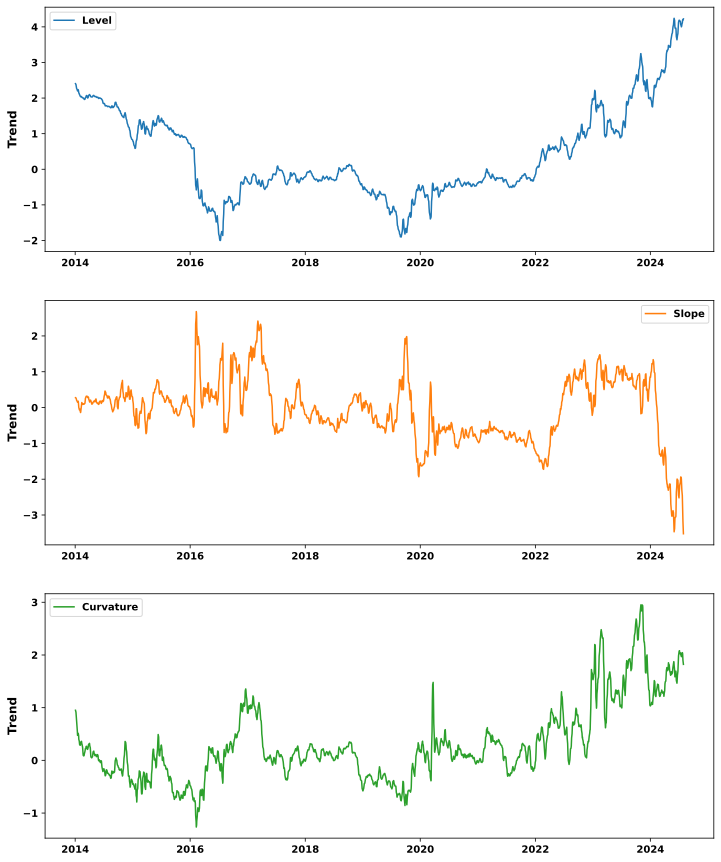

In [81]:
plot_seasonal_decomp(fa_scores, "trend")

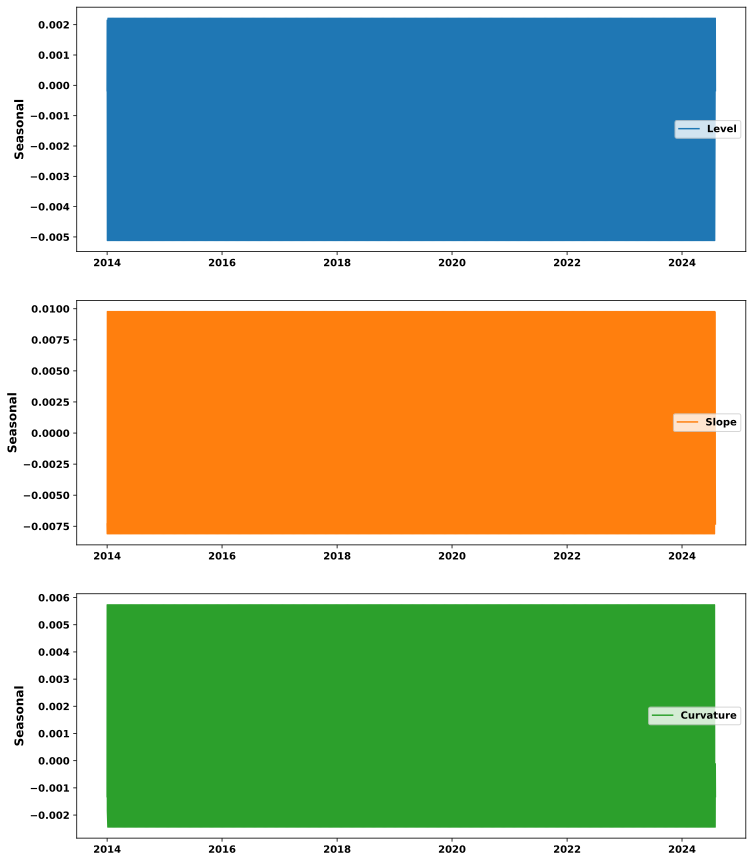

In [82]:
plot_seasonal_decomp(fa_scores, "seasonal")

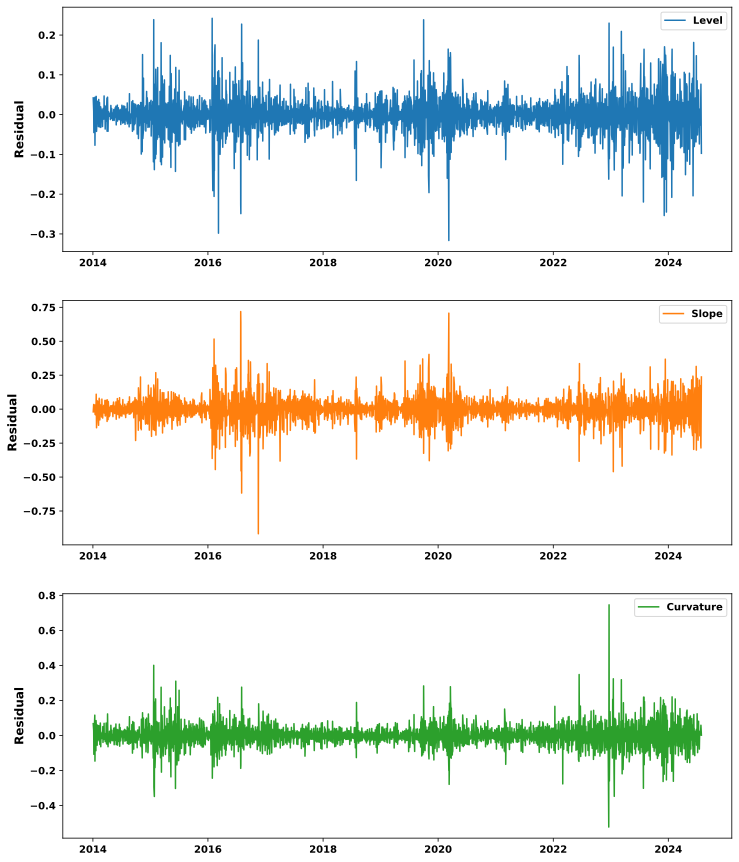

In [83]:
plot_seasonal_decomp(fa_scores, "residual")

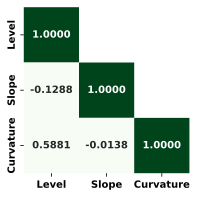

In [84]:
plot_corr_mat(fa_scores)

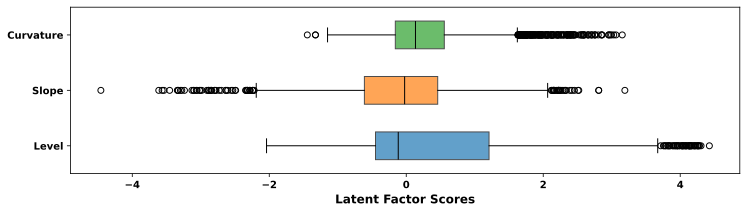

In [85]:
plot_box_whisker(fa_scores, "Latent Factor Scores")

2. **Data Reconstruction**
> Reconstruct the data from the factor score and factor loading matrices : $\hat{Z} = F \times \Lambda^T.$

In [86]:
def fa_reconstruct(fitted_scaler, fitted_fa, yields_s_df) : 
    """
    Arguments :
    - fitted_scaler : StandardScaler Estimator fitted on the unscaled yields 
    - fitted_fa : FactorAnalysis Estimator fitted on the standardized yields 
    - yields_s_df : DataFrame for the standardized yields with daily frequency  
    
    Returns :
    - reconstr_yields_df : DataFrame for the unscaled, reconstructed yields  
    
    Function :
    - Computes the dot product of the projected data (onto the top 3 latent factors) and the top 3 latent factors  
    - Inverse standardizes the resulting reconstructed yields 
    """    
    reconstr_yields_s_df = pd.DataFrame(np.dot(fitted_fa.transform(yields_s_df)[:, :3], fitted_fa.components_[:3]),
                                        index = yields_s_df.index, columns = yields_s_df.columns)
    reconstr_yields_df = pd.DataFrame(fitted_scaler.inverse_transform(reconstr_yields_s_df), 
                                      index = yields_s_df.index, columns = yields_s_df.columns)
    return reconstr_yields_df 

In [87]:
fa_yields_train = fa_reconstruct(std_scaler, fa, yields_train_s)
fa_yields_test = fa_reconstruct(std_scaler, fa, yields_test_s)
fa_yields = pd.concat(objs = [fa_yields_train, fa_yields_test], axis = 0, ignore_index = False)

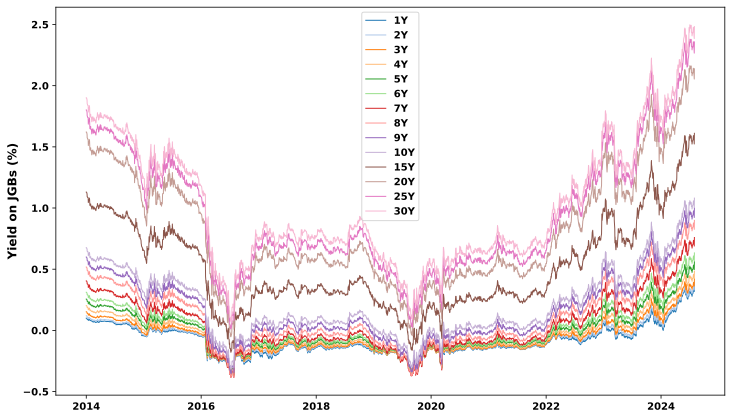

In [88]:
plot_time_series(fa_yields, "Yield on JGBs (%)")

        R^2  Adjusted R^2
1Y  91.8510       91.7915
2Y  97.3913       97.3722
3Y  98.7579       98.7489
4Y  99.1651       99.1590
5Y  99.1674       99.1613
6Y  98.9295       98.9217
7Y  98.7777       98.7688
8Y  99.1421       99.1359
9Y  99.4113       99.4070
10Y 99.1804       99.1744
15Y 99.1535       99.1474
20Y 98.6560       98.6462
25Y 98.3348       98.3226
30Y 97.6432       97.6260


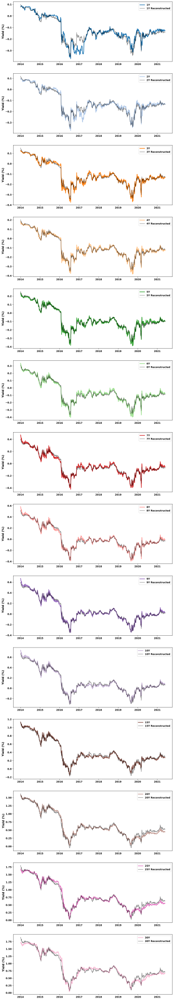

In [89]:
eval_fit(yields_train, fa_yields_train)

        R^2  Adjusted R^2
1Y  -3.4501       -5.2293
2Y  94.8686       94.7804
3Y  94.4850       94.3901
4Y  97.8016       97.7637
5Y  93.8966       93.7916
6Y  94.9780       94.8916
7Y  96.2814       96.2174
8Y  97.2681       97.2211
9Y  98.5668       98.5422
10Y 97.2328       97.1852
15Y 98.8335       98.8134
20Y 92.6175       92.4905
25Y 91.3565       91.2078
30Y 90.4112       90.2463


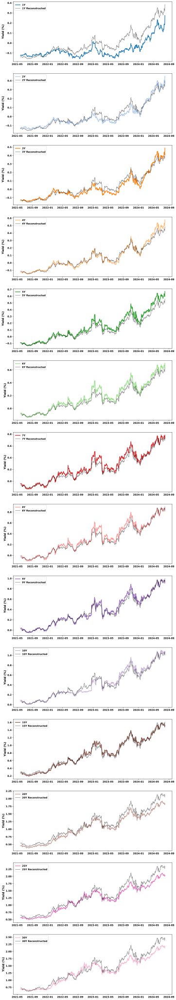

In [90]:
eval_fit(yields_test, fa_yields_test)

# Author 
[Khai Lap Vuong](https://www.linkedin.com/in/khai-lap-vuong/)